# Recommendation System for Amazon's Books

### Introduction
We are Noam Ophir (209374362) and Iftach Hivner (066542408), final-year students with a strong aspiration to pursue careers as data scientists. In our pursuit of a dataset that encapsulates the multifaceted challenges of data science, we identified a rich repository of Amazon product reviews. This discovery piqued our interest, leading us to center our project on the development of a recommendation system utilizing these reviews. Our goal is to explore and apply advanced data science techniques to generate valuable insights and personalized recommendations, ultimately enhancing the user experience on e-commerce platforms.

### The Problem
Our motivation for undertaking this project stems from a desire to delve into the realm of recommendation systems—a domain in which we previously had limited exposure—and to improve the user experience on e-commerce platforms. While Amazon has its own proprietary recommendation system, the specifics of its operation remain unknown to us, as do the extensive details of user behavior and other data, beyond what is publicly accessible.

Thus, we set out to design a personalized recommendation system tailored for Amazon users. Our objective is to assist users in discovering products that align with their interests. Traditional search methods often fall short, lacking the degree of personalization that can significantly enhance user satisfaction.

By leveraging user behavior data, performing sentiment analysis on review texts, and on products categories, our recommendation system aims to offer highly relevant suggestions. This project not only addresses a pertinent problem but also serves as an opportunity for us to deepen our understanding of this dynamic field of data science, master the challenges of working with big data, and broaden our professional horizons

### The data
To obtain the data for our project, we searched the internet for relevant databases. We found suitable datasets at [UC San Diego's Amazon product dataset](https://cseweb.ucsd.edu/~jmcauley/datasets/amazon_v2/). This dataset, which has been used in several published research papers, comprises a vast collection of Amazon product reviews that had already been scraped and made publicly available by the authors.

Given the extensive scope of the data, which encompasses a wide range of products across the entire Amazon platform, we decided to narrow our focus to the books category—a domain of personal interest for both of us. This focus enables us to delve deeper into the nuances of book recommendations while managing the complexity of working with such a large dataset.

## Exploratory Data Analysis

First, we obtained the relevant data from the aforementioned website. Next, we will conduct an exploratory data analysis to gain a deeper understanding of the dataset and its structure.



In [ ]:
import pandas as pd
import json
import numpy as np
import pyarrow as pa
import pyarrow.parquet as pq
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive')

The original JSON files were exceedingly large, making it impractical to load and display all the data simultaneously. To manage this, we downloaded the files and converted them into Parquet format, which significantly enhanced processing efficiency. Our initial approach involved working with both the books and Kindle recommendations datasets, supplemented by metadata files that had been scraped by researchers.

Below are samples from each dataset, illustrating the structure and content we worked with. Even at this early stage, we encountered issues with excessive RAM usage, necessitating a line-by-line reading of the files to avoid overloading our system.

In [ ]:
#showing random samples from the json
file_path = '/content/drive/MyDrive/Books1.json'
records = []
indices = [0, 49, 199, 499, 999]
max_index = max(indices)

with open(file_path, 'r') as file:
    # Read the file line by line to avoid loading the entire file into memory
    for i, line in enumerate(file):
        if i > max_index:
            break
        if i in indices:
            records.append(json.loads(line.strip()))

df = pd.DataFrame(records)

df.head(5)

,overall,verified,reviewTime,reviewerID,asin,style,reviewerName,reviewText,summary,unixReviewTime
0,5.0,False,"08 12, 2005",A1C6M8LCIX4M6M,0001713353,{'Format:': ' Paperback'},June Bug,This book is a winner with both of my boys. T...,Children's favorite,1123804800
1,5.0,True,"10 6, 2016",A2CVLIZ9ELU88,0001061240,{'Format:': ' Hardcover'},A.M.H.,I had this book as a child and loved it. The c...,A wonderful poetry collection with superior co...,1475712000
2,5.0,False,"08 28, 2014",A3S62U3MSPH202,0002005263,{'Format:': ' Mass Market Paperback'},L. Busse,I enjoy these books,Five Stars,1409184000
3,5.0,True,"03 29, 2017",AFS2HI8Y67T6J,0001384198,{'Format:': ' Hardcover'},Amazon Customer,Great classic book! I gave this as a shower g...,Five Stars,1490745600
4,3.0,True,"01 7, 2014",A331AFVDOICK1E,0001384198,{'Format:': ' Paperback'},PinkBird,I bough this to help my train-loving child wit...,"It's Ok, Not the Best ABC Book",1389052800


The JSON file is organized in a structured manner, containing several key columns:

**overall**: This column represents the rating, ranging from 1 to 5, in integer format.

**verified**: Indicates whether the review is from a verified purchase.

**reviewTime**: The date when the review was posted.

**reviewerID**: A unique identifier for the reviewer.

**asin**: The Amazon Standard Identification Number for the product.

**style**: Describes the format of the product, such as 'Paperback' or 'Kindle Edition.'

**reviewerName**: The name of the reviewer.

**reviewText**: The actual content of the review.

**summary**: A brief summary of the review.

**unixReviewTime**: The date of the review in Unix time format.



Next, we will examine some examples of the metadata associated with this dataset.

In [ ]:
file_path = '/content/drive/MyDrive/meta_Books.json'
records = []
indices = [0, 49, 199, 499, 999]
max_index = max(indices)

with open(file_path, 'r') as file:
    for i, line in enumerate(file):
        if i > max_index:
            break
        if i in indices:
            records.append(json.loads(line.strip()))

df = pd.DataFrame(records)

df.head(5)


,category,tech1,description,fit,title,also_buy,tech2,brand,feature,rank,also_view,main_cat,similar_item,date,price,asin,imageURL,imageURLHighRes
0,[],,[It is a biology book with God&apos;s perspect...,,Biology Gods Living Creation Third Edition 10 ...,"[0669009075, B000K2P5SA, B00MD4G2N0, B000ASIPT...",,Keith Graham,[],"1,349,781 in Books (","[0019777701, B000AUCX7I, B000K2P5SA, B001CK63X...",Books,,,$39.94,0000092878,[],[]
1,[],,[],,"Bloomberg Businessweek Magazine (April 1, 2013...",[],,Josh Tyrangiel,[],"12,376,506 in Books (",[],Books,,,$3.25,000077135X,[],[]
2,"[Books, Children's Books]",,[Another popular character makes an appearance...,,Pookie Believes in Santa Claus,"[1872885012, 1872885004, 1872885373]",,Ivy Wallace,[],"2,047,631 in Books (","[1872885004, B000MTD6ZK, 0006647324, B000MHT4K...",Books,,,,0001983806,[],[]
3,"[Books, Biographies & Memoirs, Travelers & Exp...",,[The Picnic & Suchlike Pandemonium],,The Picnic &amp; Suchlike Pandemonium,[161145865X],,Visit Amazon's Gerald Durrell Page,[],"1,913,645 in Books (","[0142004413, 161145865X, 1509827137, 156792441...",Books,,,$147.77,000216731X,[],[]
4,"[Books, Christian Books & Bibles]",,[1977 publish date],,Jesus of Nazareth,"[0060697806, B0182W7JZ6, 0664258077, 0687365902]",,Visit Amazon's William Barclay Page,[],"397,999 in Books (",[B000GLU64I],Books,,,$16.99,000250653X,[],[]


The metadata JSON file, while somewhat unstructured, provides valuable information across several columns:

**category**: Lists the categories the book belongs to.

**tech1 and tech2**: Technical details or specifications (mostly empty).

**description**: A description that also contains reviews of the book.

**fit**: Compatibility or fit information, if applicable (mostly empty).

**title**: The title of the book.

**also_buy**: A list of ASINs for items frequently bought together with this book.

**brand**: The name of the author in multiple formats.

**feature**: features of the book (mostly empty).

**rank**: The book's rank in its main category.

**also_view**: A list of ASINs for items frequently viewed together with this book.

**main_cat**: The main category of the product in amazon (mostly books in our case).

**similar_item**: Items similar to the book (mostly empty).

**date**: The publication date of the book (mostly empty).

**price**: The price of the book.

**asin**: The Amazon Standard Identification Number for the book.

**imageURL and imageURLHighRes**: URLs for images of the book in standard and high resolution (mostly empty).

The **also_view** and **also_buy** columns provide item-based recommendations, with the former showing items frequently viewed together and the latter indicating items frequently bought together.

Next, We will examine the kindle files in the same manner.

In [ ]:
file_path = '/content/drive/MyDrive/Kindle_Store.json'
records = []
indices = [0, 49, 199, 499, 999]
max_index = max(indices)

with open(file_path, 'r') as file:

    for i, line in enumerate(file):
        if i > max_index:
            break
        if i in indices:
            records.append(json.loads(line.strip()))

df = pd.DataFrame(records)

df.head(5)


,overall,verified,reviewTime,reviewerID,asin,style,reviewerName,reviewText,summary,unixReviewTime,vote
0,4.0,True,"12 29, 2012",A27UD5HYAKBL97,1423600150,{'Format:': ' Hardcover'},Cheryl,If you like making salsas this is a great book...,Great Book,1356739200,NaN
1,5.0,True,"09 16, 2013",A3O71TSZWGVPJR,B000FA64QO,{'Format:': ' Kindle Edition'},Freddy Godden,It's been a long time since I read The New Jed...,A good filler,1379289600,NaN
2,1.0,False,"02 13, 2003",A33ZYFE8XMKKR1,B000FA5KX2,{'Format:': ' Hardcover'},P. Scott Pope,There is very little information in this book ...,Avoid,1045094400,10
3,3.0,True,"08 22, 2016",A27FRLI7PFQP37,B000FBFMHU,NaN,H. Natola,Up bought this book many years after seeing th...,Interesting read,1471824000,NaN
4,4.0,True,"08 7, 2003",A213YFL3NCBSSL,B000FBFMHU,NaN,J Zimmer,"Frank Abagnale has had an extradordinary life,...",Read for the adventure not the dialog,1060214400,NaN


This file is quite similar to the previous one, but we immediately noticed integrity issues in the "style" column, which should exclusively contain Kindle formats. We will explore this discrepancy in more detail later. Additionally, this file introduces a new feature not present in the books.json: the "vote" column, which indicates whether users found a review helpful.

Next, we proceed to examine the metadata for Kindle.

In [ ]:
file_path = '/content/drive/MyDrive/meta_Kindle_Store.json'
records = []
indices = [0, 49, 199, 499, 999]
max_index = max(indices)

with open(file_path, 'r') as file:

    for i, line in enumerate(file):
        if i > max_index:
            break
        if i in indices:
            records.append(json.loads(line.strip()))

df = pd.DataFrame(records)

df.head(5)

,category,tech1,description,fit,title,also_buy,tech2,brand,feature,rank,also_view,details,main_cat,similar_item,date,price,asin,imageURL,imageURLHighRes
0,"[Kindle Store, Kindle eBooks, Science Fiction ...",,[],,,"[B007NLCJBC, B01FARODH8]",,Arthur K. Barnes,[],"1,716,849 Paid in Kindle Store (","[B000FBF81K, B00PBDMER8]","{'File Size:': '295 KB', 'Print Length:': '113...",Buy a Kindle,,,,B000FA5KKA,[],[]
1,"[Kindle Store, Kindle eBooks, Literature & Fic...",,[],,,"[B000JMKNQ0, B00A9ET67K, B000FA64PK, B000FC1BN...",,Troy Denning,[],"450,206 Paid in Kindle Store (",[],"{'File Size:': '1029 KB', 'Print Length:': '10...",Buy a Kindle,,,,B000FBFMVG,[],[]
2,"[Kindle Store, Kindle eBooks, Science Fiction ...",,[],,,[],,Stephen Adams,[],"3,391,942 Paid in Kindle Store (",[],"{'File Size:': '550 KB', 'Print Length:': '242...",Buy a Kindle,,,,B000FC1QW4,[],[]
3,"[Kindle Store, Kindle eBooks, Literature & Fic...",,[],,,[],,Visit Amazon's Wendy Etherington Page,[],"2,695,514 Paid in Kindle Store (",[],"{'File Size:': '479 KB', 'Print Length:': '256...",Buy a Kindle,,,,B000MAH9X4,[],[]
4,"[Kindle Store, Kindle eBooks, Literature & Fic...",,[],,,"[B001CQCAOU, B000SWV6H6, B000SWV6FS, B073P6H5VX]",,Visit Amazon's Emilie Rose Page,[],"674,441 Paid in Kindle Store (",[B000SWV6H6],"{'File Size:': '377 KB', 'Print Length:': '192...",Buy a Kindle,,,,B000RH0CQI,[],[]


The file is quite similar to the other meta data file we have already encountered

The next step involves splitting the files into smaller parts or chunks to facilitate working with the data without needing to load all of it at once. We applied this approach to all four files: meta_Books.json, Books.json, meta_Kindle_Store.json, and Kindle_store.json. This allowed us to efficiently manage the large datasets and perform our analyses without overwhelming system resources.

In [ ]:
# Input and output file paths
json_file_path = '/content/drive/MyDrive/Books2.json'
parquet_output_dir = '/content/drive/MyDrive/books-parquet/'

chunk_size = 50000
json_reader = pd.read_json(json_file_path, lines=True, chunksize=chunk_size)

for i, chunk in enumerate(json_reader):
    table = pa.Table.from_pandas(chunk)
    parquet_file_name = f'output_chunk_{i + 1}.parquet'
    parquet_file_path = f'{parquet_output_dir}{parquet_file_name}'
    pq.write_table(table, parquet_file_path)

print(f"Data has been successfully converted to Parquet: {parquet_file_path}")

For the metadata files, we first converted them into CSV format before further converting them into Parquet files. This process was more challenging than writing plain code, as certain characters caused issues during the conversion. To handle these difficulties, we implemented a 'try-except' approach, allowing us to manage errors gracefully and ensure the successful conversion of the files.

In [ ]:
import pandas as pd

json_file_path = '/content/drive/MyDrive/meta_Books.json'
csv_output_path = '/content/drive/MyDrive/meta-books-csv/'

# Read the JSON file in chunks with error handling and potential escape fixes
chunksize = 20000
chunk_counter = 1

try:
    for chunk in pd.read_json(json_file_path, lines=True, chunksize=chunksize):
        if chunk_counter%200==0:
          print("Current chunk is:", chunk_counter)
        processed_chunk = chunk
        output_filename = f'meta-books-csv-chunk_{chunk_counter}.csv'
        output_filepath = f'{csv_output_path}{output_filename}'

        try:
            processed_chunk.to_csv(output_filepath, index=False, quoting=csv.QUOTE_ALL, escapechar='\\')
            chunk_counter += 1
        except pd.errors.ParserError as e:
            print(f"Error processing chunk {chunk_counter}: {e}")

except pd.errors.ParserError as e:
    print("Error decoding JSON:", e)


The same conversion process was applied to the Kindle files as well.

In [ ]:
import os
from pathlib import Path

csv_directory = '/content/drive/MyDrive/meta-books-csv/'
parquet_directory = '/content/drive/MyDrive/meta-books-parquet/'
Path(parquet_directory).mkdir(parents=True, exist_ok=True)
csv_files = [file for file in os.listdir(csv_directory) if file.startswith('meta-books-csv') and file.endswith('.csv')]
counter=0

for csv_file in csv_files:
    counter+=1
    df = pd.read_csv(os.path.join(csv_directory, csv_file))
    parquet_file = os.path.join(parquet_directory, csv_file.replace('.csv', '.parquet'))
    df.to_parquet(parquet_file, engine='pyarrow')

# *Initial Steps with the Data*
We started by taking the first steps in working with the dataset. This phase involves understanding the structure of the data, identifying any immediate issues, and preparing it for the analysis that will follow. This foundational work is essential to ensure a smooth and effective data exploration process later on.

The first step in our analysis was to assess the basic characteristics of the dataset, focusing on the summaries and review texts. Specifically, we counted the number of summaries, measured their lengths, and performed the same analysis for the review texts. Given that the dataset consists of book reviews, starting with these features was a logical choice. Since this process is more technical in nature, we opted not to include the detailed code within this notebook. Instead, we concentrated on extracting and understanding these key features before moving forward.

In [ ]:
df_summary=pd.read_parquet("/content/drive/MyDrive/summary_only.parquet")

**Analyzing the Distribution of Voting**

Next, we will examine the distribution of votes in the dataset. This step is crucial to understanding how users have interacted with the reviews, particularly in terms of upvotes or downvotes, which can offer insights into the perceived helpfulness or relevance of the reviews. By analyzing the voting distribution, we can better understand patterns of user engagement and the overall dynamics of the review system.


In [ ]:
base_path = "/content/drive/MyDrive/books_to_kindle_and_books_parquets/books/books_"
extension = ".parquet"

# Number of files
num_files = 7
# Initialize an empty DataFrame to store the results
all_data = pd.DataFrame()
# Loop through the file numbers and read the 'overall' column
for i in range(1, num_files + 1):
    file_path = f"{base_path}{i}{extension}"
    df = pd.read_parquet(file_path, columns=['overall'])
    all_data = pd.concat([all_data, df], ignore_index=True)

In [ ]:
base_path = "/content/drive/MyDrive/books_to_kindle_and_books_parquets/kindle/kindle_"
extension = ".parquet"
num_files = 7

for i in range(1, num_files + 1):
    file_path = f"{base_path}{i}{extension}"
    df = pd.read_parquet(file_path, columns=['overall'])
    all_data = pd.concat([all_data, df], ignore_index=True)

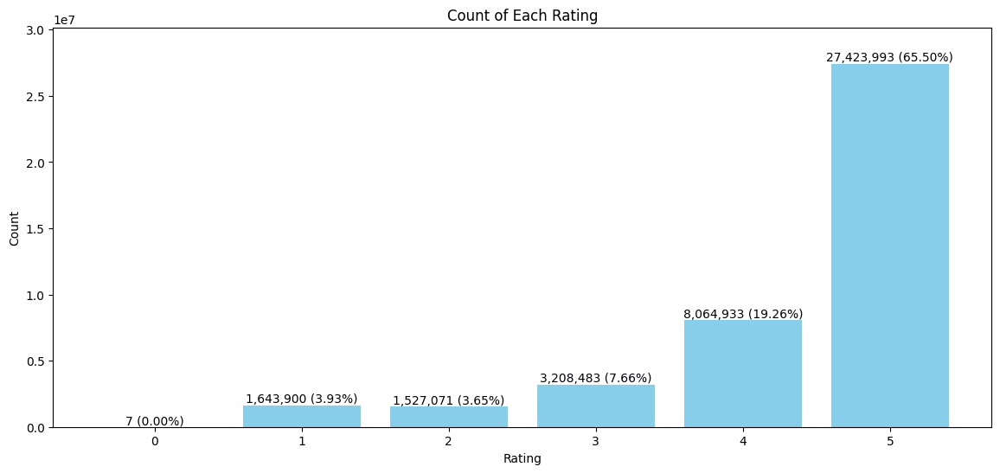

In [ ]:

rating_counts = all_data['overall'].value_counts().sort_index()
total_count = rating_counts.sum()
plt.figure(figsize=(14, 6))
bars = plt.bar(rating_counts.index, rating_counts.values, color='skyblue')

for bar in bars:
    yval = bar.get_height()
    pct = (yval / total_count) * 100
    plt.text(bar.get_x() + bar.get_width()/2, yval + 5, f'{yval:,} ({pct:.2f}%)', ha='center', va='bottom', fontsize=10)

plt.xlabel('Rating')
plt.ylabel('Count')
plt.title('Count of Each Rating')
plt.xticks(rating_counts.index)
plt.ylim(0, rating_counts.max() * 1.1)  # Adding some space on top
plt.show()

The distribution of ratings is highly skewed, as evidenced by the bar chart. It is clear that the ratings are neither normally nor evenly distributed. The vast majority of the ratings are concentrated at 5, with ratings of 4 and 5 together comprising nearly the entire dataset. This pattern suggests that users who have a positive experience with a book are far more likely to leave a review, while those who find a book mediocre or only somewhat satisfying may not feel compelled to provide feedback. Additionally, it appears that very few readers felt strongly enough to rate a book poorly, with ratings of 1 and 2 being extremely rare. This imbalance could reflect a tendency among reviewers to share positive experiences more frequently, or it could indicate that users who dislike a book might simply choose not to rate it at all.

**Checking for Missing Values**

The first critical step is to check for any missing values in our dataset. Since our recommendation system relies heavily on the available reviews, it's essential to ensure that we have sufficient and complete data to work with. Identifying and addressing missing values early on will help us maintain the integrity of our analysis and the effectiveness of the recommendation system.

In [ ]:
df_summary.isna().sum()

summary    11304
dtype: int64

Fortunately, there are only a few missing values in the summaries, which is a positive sign. This indicates that most reviewers took the time to provide a summary, which could be valuable for extracting insights later on. These summaries might offer additional context or highlight key points that can enhance the accuracy and relevance of our recommendation system.

In [ ]:
df_summary['length'] = df_summary['summary'].apply(lambda x: len(x) if x is not None else 0)


Next, we examined the distribution of the lengths of the summaries. Understanding how long or short the summaries typically are can provide insights into the level of detail reviewers tend to include. This information is valuable for determining how summary length might correlate with the usefulness of a review or the effectiveness of the recommendation system.

In [ ]:
df_summary['length'].value_counts().sort_index()

length
0        11304
1        12835
2        55886
3       159269
4       348708
         ...  
1451         1
1527         1
1601         1
1730         1
2482         1
Name: count, Length: 643, dtype: int64

We noticed a significant variation in the length of summaries—while most users provided concise summaries, a few included extremely long ones. To better understand this distribution, we decided to focus on the 90th quantile. This approach helps us identify the threshold where the majority of summaries fall, allowing us to distinguish between typical summary lengths and outliers.

In [ ]:
quantile_90 = df_summary['length'].quantile(0.90)

quantile_90

53.0

To effectively visualize the distribution of summary lengths, we created a histogram. Histograms are particularly useful for this purpose, as they provide a clear and intuitive way to observe how summary lengths are distributed across the dataset, highlighting any patterns or anomalies such as the concentration of shorter summaries and the presence of unusually long ones.

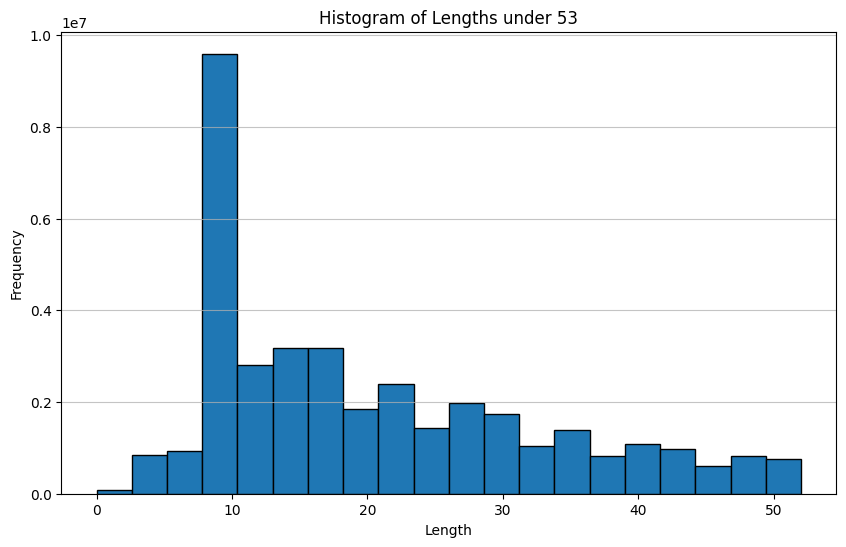

In [ ]:
lengths_under_53 = df_summary[df_summary['length'] < 53]['length']
plt.figure(figsize=(10, 6))
n, bins, patches = plt.hist(lengths_under_53, bins=20, edgecolor='black')
plt.title('Histogram of Lengths under 53')
plt.xlabel('Length')
plt.ylabel('Frequency')
plt.grid(axis='y', alpha=0.75)
plt.show()

The histogram clearly illustrates that the majority of summaries fall within the 1 to 30-word range, with frequency gradually diminishing beyond that point. This distribution suggests that most users tend to write relatively short summaries. This trend is understandable given the diverse audience of book reviewers—ranging from parents buying children's books to enthusiasts of dense historical volumes. The data reflects the broad spectrum of users, each with different preferences and reasons for reviewing, leading to varied summary lengths.

Next, we will conduct a similar analysis for the reviews.

In [ ]:
df_books_review=pd.read_parquet("/content/drive/MyDrive/books_reviewertext_length.parquet")
df_kinlde_review=pd.read_parquet("/content/drive/MyDrive/kindle_reviewertext_length.parquet")

In [ ]:
df_books_review.isna().sum()

reviewerID    0
length        0
dtype: int64

In [ ]:
df_kinlde_review.isna().sum()

reviewerID    0
length        0
dtype: int64

We observed that all samples in both the books and Kindle files contain reviews, which speaks to the quality of the data. As part of our exploratory data analysis (EDA), we'll apply this process to both datasets to gain a deeper understanding of their characteristics.

Next, we proceeded to calculate the lengths of reviews in both the books and Kindle datasets. Afterward, we'll visualize these distributions by creating histograms.

In [ ]:
df_books_review['length'].value_counts().sort_index()

length
0         5695
1         3970
2        31596
3        10865
4        88093
         ...  
34241        1
34254        1
34283        1
34406        1
35094        1
Name: count, Length: 17156, dtype: int64

In [ ]:
df_kinlde_review['length'].value_counts().sort_index()

length
0         4718
1         4276
2        16707
3         6756
4        40894
         ...  
32619        1
32645        1
32768        1
32771        1
33860        1
Name: count, Length: 11274, dtype: int64

Similar to our approach with the summaries, we checked the 90th quantile for review lengths due to the presence of some exceptionally long reviews. This analysis allows us to identify the upper range of typical review lengths, helping us understand where most reviews fall and to distinguish the longer, more detailed reviews from the majority.


In [ ]:
quantile_90 = df_books_review['length'].quantile(0.50)

quantile_90

260.0

In [ ]:
quantile_90 = df_kinlde_review['length'].quantile(0.50)

quantile_90

169.0

An interesting phenomenon emerged during our analysis: both the 90th percentile and the median review lengths are significantly longer in the Kindle dataset compared to the books dataset. This suggests that users writing reviews for Kindle editions tend to provide more detailed and extensive feedback than those reviewing physical books.

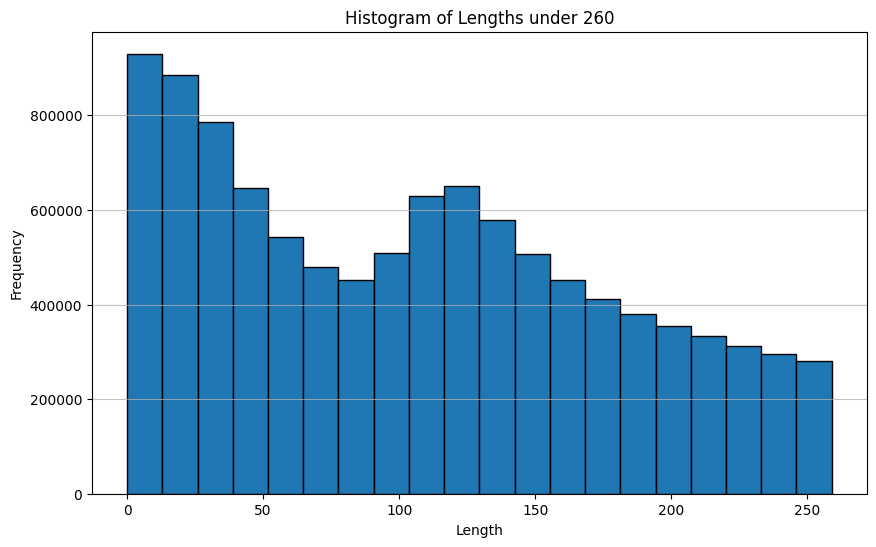

In [ ]:
lengths_under_260 = df_books_review[df_books_review['length'] < 260]['length']
plt.figure(figsize=(10, 6))
n, bins, patches = plt.hist(lengths_under_260, bins=20, edgecolor='black')
plt.title('Histogram of Lengths under 260')
plt.xlabel('Length')
plt.ylabel('Frequency')
plt.grid(axis='y', alpha=0.75)
plt.show()

This histogram presents a broad range of review lengths, from very short to quite lengthy. The distribution shows a noticeable trend where most reviews are under 150 words. This aligns with the expectation that, over time, people are less inclined to write detailed, well-reasoned comments and reviews online. The histogram captures this shift in behavior, highlighting the prevalence of shorter, more concise reviews in the dataset.

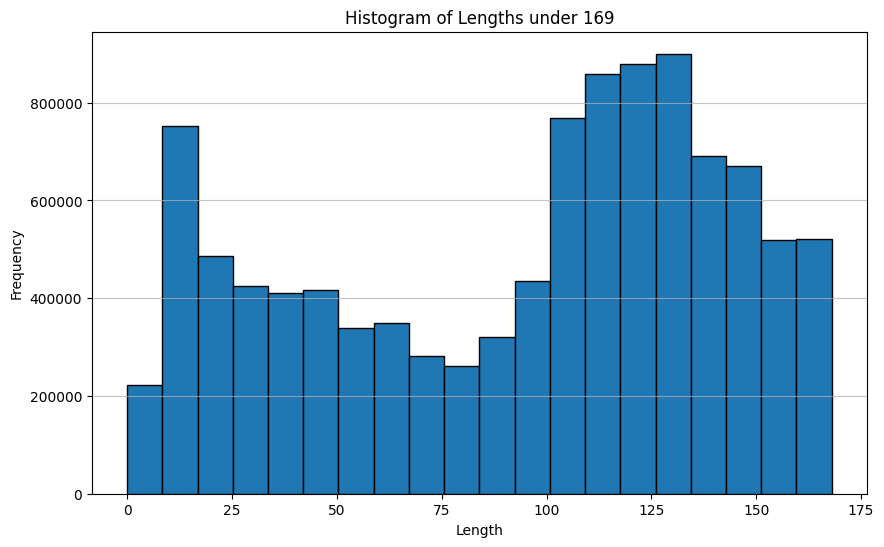

In [ ]:

lengths_under_169 = df_kinlde_review[df_kinlde_review['length'] < 169]['length']
plt.figure(figsize=(10, 6))
n, bins, patches = plt.hist(lengths_under_169, bins=20, edgecolor='black')
plt.title('Histogram of Lengths under 169')
plt.xlabel('Length')
plt.ylabel('Frequency')
plt.grid(axis='y', alpha=0.75)
plt.show()

This histogram reveals a surprising pattern: reviews with over 100 words have a higher frequency than shorter reviews, contrary to what we initially anticipated. This unexpected spike suggests that a significant portion of users still invest time in writing more detailed reviews. However, without additional information about the reviewers, we cannot delve deeper into the reasons behind this trend. Nonetheless, while intriguing, this finding may not be critical to our overall analysis.

**Initial User Activity Analysis: Review Count Threshold**

To gain an initial understanding of user behavior, we checked if users had more than 10 reviews. We established that 10 reviews is the minimum number required per user to effectively train and test our recommendation system. Without reaching this threshold, it becomes difficult to predict users' behavior and build a robust system based on it.

To facilitate this analysis, we created a combined file called "Both" that includes the 'reviewerID' from both the books and Kindle datasets. We then ran queries to determine how many users had more than 10 reviews across both sources. This preliminary step was crucial for getting an initial feel for the data and assessing whether our dataset meets the requirements for further analysis.

In [ ]:
import polars as pl
all_reviewer_ids = pl.DataFrame(schema={'reviewerID': pl.Utf8})  # Use Utf8 for strings
path_to_parquet_files = '/content/drive/MyDrive/books-parquet/'
# Accumulate reviewer IDs
for i in range(1, 1027):
    file_path = path_to_parquet_files + f"output_chunk_{i+1}.parquet"
    df = pl.read_parquet(file_path, columns=["reviewerID"])
    all_reviewer_ids = pl.concat([all_reviewer_ids, df])
reviewer_ids = pd.DataFrame(all_reviewer_ids)
reviewer_ids.columns = ['reviewerID']
reviewer_ids['source']='books'
reviewer_ids.to_csv('books_reviewerID.csv', index=False)

In [ ]:
# Group by reviewerID and count the occurrences
reviewer_id_counts = all_reviewer_ids.value_counts().reset_index()
reviewer_id_counts.columns = ['reviewerID', 'count']
print(reviewer_id_counts.head())

       reviewerID  count
0  A1D2C0WDCSHUWZ    697
1  A2F6N60Z96CAJI    479
2  A1K1JW1C5CUSUZ    353
3  A2OJW07GQRNJUT    278
4  A1X8VZWTOG8IS6    243


The same process was repeated for the Kindle dataset, excluding the grouping and counting step (value_counts()), to ensure we consistently gathered and processed the reviewerIDs from both datasets.

To better understand the distribution of reviewers across both datasets (books and Kindle), we added a source column to each DataFrame. This column allows us to identify the origin of each record—whether it comes from the books dataset or the Kindle dataset.

After combining the datasets, we used plotly.express to visualize the overlap between reviewers who have reviews in both sources. This visualization helps us see how many reviewers are active in both formats and how many are unique to each, providing insights into user behavior and preferences across different reading platforms.

In [ ]:
csv_file_path = '/content/drive/MyDrive/books_reviewerID.parquet'
books_df = pd.read_parquet(csv_file_path)
books_df['source']='books'
parquet_file_path = '/content/drive/MyDrive/kindle_reviewerID.parquet'
kindle_df = pd.read_parquet(parquet_file_path)
kindle_df['source'] = 'kindle'
combined_df = pd.concat([books_df, kindle_df], ignore_index=True)
output_file_path = 'reviewerID_both.csv'
combined_df.to_csv(output_file_path, index=False)
#print(f"Data saved to {output_file_path}")

In [ ]:
# Group by reviewerID and count the occurrences of each source
reviewer_source_counts = combined_df.groupby('reviewerID')['source'].value_counts().unstack(fill_value=0)

reviewer_source_counts.reset_index(inplace=True)

reviewer_source_counts.columns = ['reviewerID', 'count_books', 'count_kindle']

print(reviewer_source_counts.head())

reviewer_source_counts.to_csv('grouped_reviewerID_count.csv', index=False)

In [ ]:
reviewer_source_counts=pd.read_csv('/content/drive/MyDrive/grouped_reviewerID_count.csv')

We then visualize the amount of reviews, only for users with over 10 reviews in both the books and Kindle datasets.

In [ ]:
import plotly.express as px

# Filter the DataFrame to include only rows where both counts are greater than 10
filtered_df = reviewer_source_counts[(reviewer_source_counts['count_books'] > 10) &
                                     (reviewer_source_counts['count_kindle'] > 10)]
# Create  scatter plot
fig = px.scatter(filtered_df, x='count_books', y='count_kindle',
                 title='Comparison of Book and Kindle Reviews per Reviewer (Counts > 10)',
                 labels={'count_books': 'Count of Books Reviews', 'count_kindle': 'Count of Kindle Reviews'})

fig.update_layout(xaxis=dict(scaleanchor='y',scaleratio=1),yaxis=dict(scaleanchor='x',scaleratio=1))
fig.show()


The scatter plot reveals a few key insights about users who have reviewed both physical books and Kindle editions, with more than 10 reviews in each category:

**Overlap in Reviewers:**


There is a significant number of users who have reviewed both books and Kindle editions, indicating a considerable overlap in user engagement across these formats.

**Tendency Toward Book Reviews:**

The plot shows a tendency for reviewers to have slightly more reviews for physical books than for Kindle editions. While some users are active in both categories, many have a stronger focus on reviewing physical books.

**Review Distribution:**

The majority of reviewers fall within the lower range of review counts for both formats. However, there are a few outliers who have reviewed thousands of books, with a lesser but still notable amount of Kindle reviews.

In the next step, we visualized the distribution of reviewers based on their review counts, separately for books and Kindle editions, for users with over 10 reviews.

In [ ]:
review_counts_books = books_df.groupby('reviewerID').size()
reviewers_with_more_than_10_books = review_counts_books[review_counts_books >= 10]
fig = px.histogram(reviewers_with_more_than_10_books, x=reviewers_with_more_than_10_books.values,
                   nbins=int(reviewers_with_more_than_10_books.max() / 25),
                   labels={'x': 'Review Counts', 'y': 'Number of Reviewers'},
                   title='Distribution of Review Counts per Reviewer')
fig.update_layout(bargap=0.2)
fig.show()

As seen from the graph, the majority of reviewers have contributed fewer than 1,000 reviews, with a significant portion contributing fewer than 100 reviews. This suggests that while there are some highly active reviewers, most users tend to write reviews less frequently.
In addition, there is a long tail in the distribution, indicating that only a small number of users have written a very large number of reviews (upwards of several thousand). These prolific reviewers are outliers compared to the broader user base.
The pattern observed aligns with typical user behavior on online platforms, where a small number of users are highly active, but most users contribute only occasionally.

Now, we shift our focus to examining the reviews specifically within the Kindle dataset.

In [ ]:
review_counts_kindle = kindle_df.groupby('reviewerID').size()
reviewers_with_more_than_10_kindle = review_counts_kindle[review_counts_kindle >= 10]
fig = px.histogram(reviewers_with_more_than_10_kindle, x=reviewers_with_more_than_10_kindle.values,
                   nbins=int(reviewers_with_more_than_10_kindle.max() / 25),
                   labels={'x': 'Review Counts', 'y': 'Number of Reviewers'},
                   title='Distribution of Review Counts per Reviewer')
fig.update_layout(bargap=0.2)
fig.show()

As expected, the vast majority of Kindle reviewers have contributed fewer than 1,000 reviews, with a large portion contributing fewer than 100 reviews. This indicates that most users engage in reviewing only occasionally.
To ensure our recommendation system effectively captures user preferences, we plan to focus on reviewers who have provided at least 10 reviews. This threshold will help us gather sufficient data on individual users' tastes, which is crucial for user-based recommendations.
The graph also shows a few reviewers who stand out as outliers, with a significantly higher number of reviews. These highly active users provide a wealth of data that could be particularly valuable for refining our recommendation algorithms.

Next, we wanted to check how many users have more than 10 reviews in one but not the other, again, just to get an idea of the data. The reasoning in the beginning was also to perhaps take users who have more than 10 reviews in both kinds of the scraped files, books and kindle.

In [ ]:
reviewer_source_counts[(reviewer_source_counts['count_books']>10) & (reviewer_source_counts['count_kindle']<10)]

,reviewerID,count_books,count_kindle
16,A00037304EKN1SJNQV5A,13,0
17,A000392684P4JNLQRBBW,12,1
73,A0015332H21AK8WZ0ZCS,13,1
216,A0042814FUEOXHEB05SQ,22,3
224,A0044294CPA1QY04FSGM,14,1
...,...,...,...
15991281,AZZY4W8E5AX2K,26,3
15991322,AZZYKHA63LQ7A,65,2
15991342,AZZYPJRSGXWSK,26,1
15991355,AZZYVTX23JWKM,21,2


In [ ]:
reviewer_source_counts[(reviewer_source_counts['count_books']<10) & (reviewer_source_counts['count_kindle']>10)]

,reviewerID,count_books,count_kindle
5040,A10028CM1L3CV8,7,12
5227,A100443KQDL0G9,8,15
6779,A100M0VHTEOWN2,5,11
7139,A100POKZLCEFWI,8,16
8148,A10112P0OZNFRC,9,13
...,...,...,...
15983430,AZXHRKV6OESUY,9,13
15984443,AZXT63K599YX8,3,12
15987602,AZYSCBAZ940SR,7,26
15988121,AZYYBBC73BQ,3,11


This little analysis provides us with many users who are not dual reviewers, and might behave differently.

### Coherency

To ensure the **coherency** of our data, we next examined the style columns in each of our JSON files. We have already previously seen that this might be an issue.
An extraction process for the style feature already took place.

In [ ]:
df=pq.read_table('/content/drive/MyDrive/books_only_style_column.parquet')
df=df.to_pandas()
filtered_counts =df['style'].value_counts(sort=True)
print(filtered_counts)

style
{'Format:': ' Kindle Edition'}                 17172000
{'Format:': ' Paperback'}                       8129082
{'Format:': ' Hardcover'}                       5152115
{'Format:': ' Mass Market Paperback'}           1023654
{'Format:': ' Board book'}                       206655
                                                 ...   
{'Color:': ' School Pop', 'Format:': None}            1
{'Format:': ' Videotape'}                             1
{'Color:': ' Super Power', 'Format:': None}           1
{'Format:': ' Puzzle'}                                1
{'Format:': ' Unbound', 'Style:': None}               1
Name: count, Length: 292, dtype: int64


Upon examining the style columns, we observed that the dataset includes entries for items such as videotapes and puzzles, which are unrelated to books and Kindle editions. This indicates a lack of coherency in the dataset, as it should be exclusively focused on book-related products.

we visualized the top 10 most common styles:

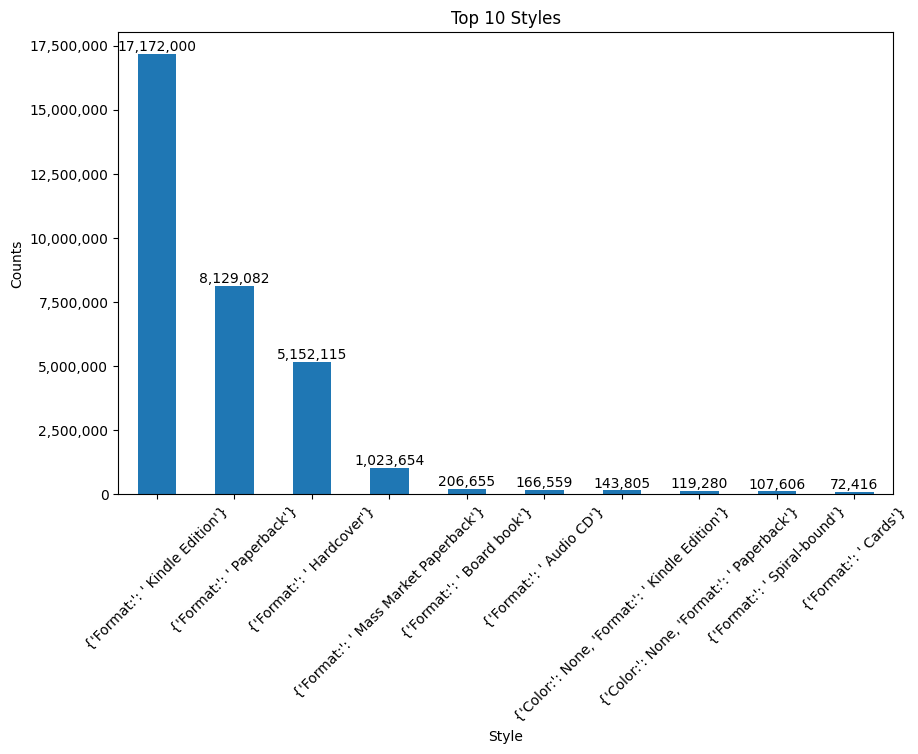

In [ ]:
from matplotlib.ticker import ScalarFormatter
from matplotlib.ticker import FuncFormatter
filtered_counts = df['style'].value_counts(sort=True)
top_10 = filtered_counts.head(10)
plt.figure(figsize=(10, 6))
ax = top_10.plot(kind='bar')
plt.title('Top 10 Styles')
plt.xlabel('Style')
plt.ylabel('Counts')
plt.xticks(rotation=45)
formatter = FuncFormatter(lambda x, pos: '{:,.0f}'.format(x))
ax.yaxis.set_major_formatter(formatter)
for index, value in enumerate(top_10):
    ax.text(index, value, f'{value:,.0f}', ha='center', va='bottom')
plt.show()

The bar chart clearly shows that the vast majority of reviews are associated with the top 4 styles:

The **Kindle Edition, Paperback, Hardcover,** and **Mass Market Paperback** styles dominate the dataset, accounting for the majority of entries. This confirms that most of the data is indeed book-related, which aligns with our expectations for the dataset.
Notably, Kindle Edition appears in the books dataset, which shouldn't have happened since the books scraping was intended to exclude Kindle formats.

Next, we perform a similar coherency check on the Kindle file

In [ ]:
df=pd.read_csv('/content/drive/MyDrive/kindle_style_only.csv')
df.columns=[['reviewerID','style']]
filtered_counts =df['style'].value_counts(sort=True)
print(filtered_counts.head())

(style,)                             
{'Format:': ' Kindle Edition'}           5045160
{'Format:': ' Paperback'}                 165154
{'Format:': ' Hardcover'}                  72067
{'Format:': ' Mass Market Paperback'}      10295
{'Format:': ' Audible Audiobook'}           6455
Name: count, dtype: int64


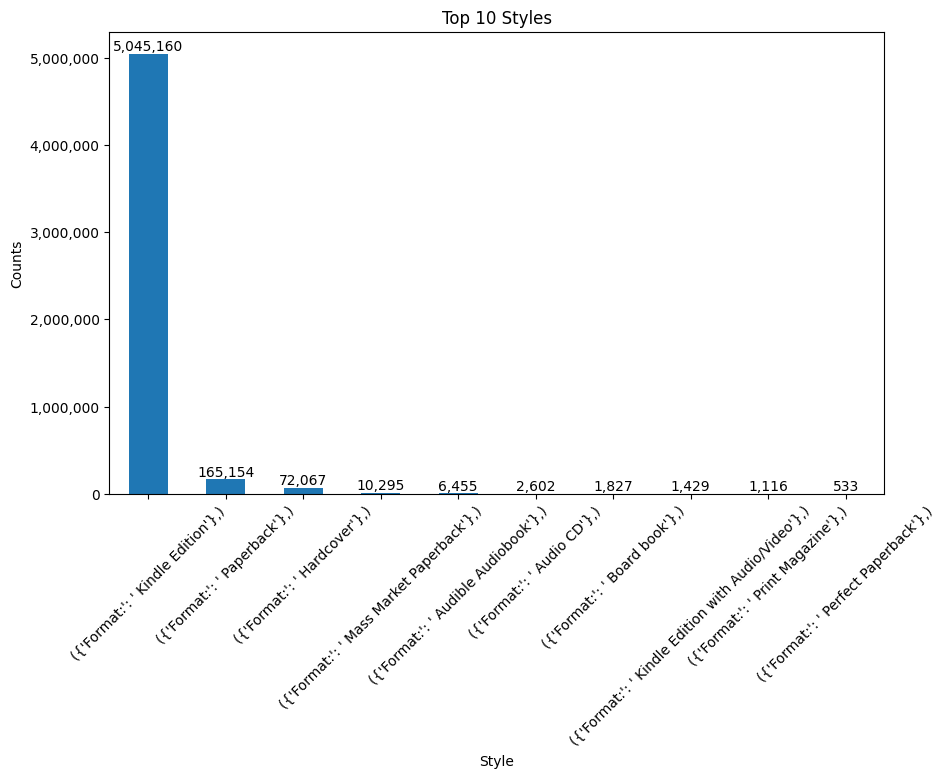

In [ ]:
filtered_counts = df['style'].value_counts(sort=True)
top_10 = filtered_counts.head(10)
# Create a bar graph
plt.figure(figsize=(10, 6))
ax = top_10.plot(kind='bar')
plt.title('Top 10 Styles')
plt.xlabel('Style')
plt.ylabel('Counts')
plt.xticks(rotation=45)
formatter = FuncFormatter(lambda x, pos: '{:,.0f}'.format(x))
ax.yaxis.set_major_formatter(formatter)
for index, value in enumerate(top_10):
    ax.text(index, value, f'{value:,.0f}', ha='center', va='bottom')
plt.show()

Although most records are relevant to Kindle, some entries are still irrelevant, indicating that the data is dirty. Given the large size of the files and the limitations of working with them in a RAM-constrained environment, we have decided to proceed with only the books.json file.

Despite the presence of Kindle reviews within the books.json file, we now plan to treat this category separately. We will focus exclusively on the first four formats—Kindle Edition, Paperback, Hardcover, and Mass Market Paperback—as these provide sufficient records and are most relevant to our analysis. This approach allows us to maintain data quality while efficiently managing the dataset size.

To prepare the dataset for analysis, we undertook the preprocessing steps of removing irrelevant fields and
dividing the dataset.
We removed unnecessary fields from the dataset, including reviewTime, unixReviewTime, and Image. These fields were not relevant to our analysis and eliminating them helped reduce the dataset's size.
We then divided the dataset into two categories: Kindle and Books, based on the formats.
Each category was saved into 7 separate files to manage the large size of the data more efficiently and ensure smoother processing.

 An example of how we worked with the first file is shown:

In [ ]:
first_book_after_preprocessing=pl.read_parquet("/content/drive/MyDrive/books_to_kindle_and_books_parquets/books/books_1.parquet")
first_book_after_preprocessing=first_book_after_preprocessing.to_pandas()

the next step was to check for unique values in each of the columns

In [ ]:
column_details = [(column, first_book_after_preprocessing[column].nunique(), first_book_after_preprocessing[column].dtype) for column in first_book_after_preprocessing.columns if column != "style"]
column_summary_df = pd.DataFrame(column_details, columns=['feature name', 'unique', 'type'])
print(column_summary_df)

   feature name   unique    type
0       overall        5   int64
1      verified        2    bool
2    reviewerID  2120679  object
3          asin    70325  object
4  reviewerName  1416147  object
5    reviewText  3485673  object
6       summary  2308730  object
7          vote     1562  object


The analysis of unique values in each column provides encouraging insights:

overall: Contains 5 unique integer values, corresponding to the expected rating scale from 1 to 5.
verified: A boolean column with 2 unique values, indicating whether the review was verified.
reviewerID & reviewerName: With over 2 million unique reviewerIDs and around 1.4 million unique reviewerNames, we can confirm a large and diverse set of reviewers.
asin: Over 70,000 unique ASINs, indicating a wide variety of products reviewed.
reviewText & summary: Both columns have a high number of unique values, with over 3.4 million unique review texts and over 2.3 million unique summaries, suggesting minimal duplication in the data.

**Handling missing values:**


The first step in cleaning the dataset is to address any NA (Not Available) values

In [ ]:
first_book_after_preprocessing.apply(lambda col: col.isin(["nan", "NaN", "None"]).sum())

overall               0
verified              0
reviewerID            0
asin                  0
style                 0
reviewerName        118
reviewText           86
summary              20
vote            2548621
dtype: int64

vote Column:

Out of 3.4 million reviews, the vast majority of vote values are NA. Since this column does not provide consistent or additional useful information, we decided to discard it.

reviewerName Column:

The reviewerName column has 118 NA values. However, since our recommendation system will be based on reviewerID, reviewerName is not essential for our analysis. We have therefore decided to remove this column as well.

In [ ]:
first_book_after_preprocessing.drop(columns=["vote", "reviewerName"], inplace=True)
# Convert "nan", "NaN", "None", and empty strings to np.nan in the new DataFrame
first_book_after_preprocessing.replace(["nan", "NaN", "None", ""], np.nan, inplace=True)
first_book_after_preprocessing.dropna(inplace=True)

Due to different variable type, in order to prevent potential issues related to variable types, we standardized the style column by converting it to a string format


In [ ]:
first_book_after_preprocessing["style"] = first_book_after_preprocessing["style"].astype(str)

In [ ]:
print(first_book_after_preprocessing.duplicated().sum())


3356


Upon checking for duplicates in the preprocessed dataset, we found 3,356 duplicate entries out of the entire first file. While this number is relatively small compared to the overall dataset, it's still important to address these duplicates to ensure the quality and integrity of our data.

In [ ]:
duplicates = first_book_after_preprocessing.duplicated(keep=False)
duplicate_rows = first_book_after_preprocessing[duplicates]
duplicate_rows.head()

,overall,verified,reviewerID,asin,style,reviewText,summary
1007,5,False,AN4RKQM9AYVAD,0001384198,{'Format:': ' Hardcover'},I liked this book because it motivated me to d...,This book is good for anyone who have kids.
1008,5,False,AN4RKQM9AYVAD,0001384198,{'Format:': ' Hardcover'},I liked this book because it motivated me to d...,This book is good for anyone who have kids.
1170,5,True,A3IVT3UA3ZERWQ,0001381733,{'Format:': ' Hardcover'},Excellent!!,Excellent!!
1171,5,True,A3IVT3UA3ZERWQ,0001381733,{'Format:': ' Hardcover'},Excellent!!,Excellent!!
1195,5,True,A3PYRSATCV6329,0001381733,{'Format:': ' Hardcover'},A gift,Five Stars


Given that the duplicates appear to be valid reviews but constitute an insignificant portion of the overall dataset, the safest and most efficient approach is to remove them. This ensures that our analysis is based on unique entries, which reduces redundancy and potential bias in our model.

In [ ]:
first_book_after_preprocessing.drop_duplicates(keep=False, inplace=True)

To ensure data integrity, we need to check whether any users have reviewed the same book more than once. This scenario is generally uncommon and could indicate duplicate or erroneous entries that should be addressed

In [ ]:
reviews_count = first_book_after_preprocessing.groupby(['reviewerID', 'asin']).size().reset_index(name='number_of_reviews').sort_values(by='number_of_reviews', ascending=False)
reviews_count.head()

,reviewerID,asin,number_of_reviews
1797847,A2TXR85WQLE32N,0140324623,57
352583,A1D2C0WDCSHUWZ,000711835X,35
352629,A1D2C0WDCSHUWZ,0007350783,20
352554,A1D2C0WDCSHUWZ,0001844423,17
640152,A1NF9WS7RR82MX,0142800376,16


In [ ]:
(reviews_count[reviews_count["number_of_reviews"] > 1])["number_of_reviews"].sum()

43520

The initial analysis revealed that certain users, such as **A1D2C0WDCSHUWZ**, have reviewed the same book multiple times—some with a surprisingly high number of reviews (e.g., 57 reviews for the same book). This is unexpected and suggests that there might be underlying issues in the data that need further investigation. Given that the reviewerID **A1D2C0WDCSHUWZ** appears multiple times with a high number of reviews for different ASINs, we decided to start by closely examining this user’s reviews.

In [ ]:
filtered_df = first_book_after_preprocessing[(first_book_after_preprocessing['reviewerID'] == 'A1D2C0WDCSHUWZ') & (first_book_after_preprocessing['asin'] == '0007350783')]
filtered_df.head(20)

,overall,verified,reviewerID,asin,style,reviewText,summary
194890,4,False,A1D2C0WDCSHUWZ,0007350783,{'Format:': ' Hardcover'},"""Emma Woodhouse, handsome, clever, and rich, w...",It's such a happiness when good people get tog...
195068,4,False,A1D2C0WDCSHUWZ,0007350783,{'Format:': ' Paperback'},"""Emma Woodhouse, handsome, clever, and rich, w...",It's such a happiness when good people get tog...
196692,5,False,A1D2C0WDCSHUWZ,0007350783,{'Format:': ' Paperback'},Gothic romances were all the rage in the late ...,When a young lady is to be a heroine
196718,5,False,A1D2C0WDCSHUWZ,0007350783,{'Format:': ' Paperback'},"In Jane Austen's time, young women were taught...",A second
196939,5,False,A1D2C0WDCSHUWZ,0007350783,{'Format:': ' Hardcover'},Gothic romances were all the rage in the late ...,When a young lady is to be a heroine
196940,5,False,A1D2C0WDCSHUWZ,0007350783,{'Format:': ' Paperback'},"One of the Dashwood daughters is smart, down-t...",The sensitive and the sensible
199395,4,False,A1D2C0WDCSHUWZ,0007350783,{'Format:': ' Paperback'},"""Emma Woodhouse, handsome, clever, and rich, w...",It's such a happiness
199837,5,False,A1D2C0WDCSHUWZ,0007350783,{'Format:': ' Paperback'},"""Emma Woodhouse, handsome, clever, and rich, w...",It's such a happiness...
200148,4,False,A1D2C0WDCSHUWZ,0007350783,{'Format:': ' Hardcover'},Even the best authors in the world sometimes p...,Everybody likes to go their own way
200182,5,False,A1D2C0WDCSHUWZ,0007350783,{'Format:': ' Mass Market Paperback'},"""Emma Woodhouse, handsome, clever, and rich, w...",It's such a happiness...


We receievd a strange result, many critics for same books, in different styles. We went back to search for the reviewerName, which is E.A. Solinas.

Upon further investigation, it turns out that the multiple reviews we observed from the user E.A. Solinas were indeed valid. These reviews were not duplicates in the traditional sense but rather reviews of the same book Emma by Jane Austen, listed under different editions and formats on Amazon:
https://www.amazon.com/Emma-Be-Classics-Jane-Austen/dp/0142419680

https://www.amazon.com/Emma-Knickerbocker-Classics-Jane-Austen/dp/1631060708 https://www.amazon.ca/product-reviews/B0C1KX3MQQ/ref=zg_bsnr_1051378_cr_sccl_1/000-0000000-0000000

 Additionally, the user reviewed other works by the same author, https://www.amazon.com.au/Northanger-Abbey-Jane-Austen-ebook/dp/B07XXWBYX6


We see that for the same reviewerID, and same asin there are different reviews, which while searching the web shows us different books. The question is whether we can tell which book is really the one that the reviewer had reviewed using the metadata file and perhaps save this data.

**Transition to Metadata Files**

In [ ]:
base_file_name = 'meta-books-csv-chunk_{}.parquet'
file_location = '/content/drive/MyDrive/meta-books-parquet/'
start_file_number = 1
meta_books_df = pd.DataFrame()
for file_number in range(start_file_number, end_file_number + 1):
    file_path = file_location + base_file_name.format(file_number)
    df = pd.read_parquet(file_path)
    meta_books_df = pd.concat([meta_books_df, df], ignore_index=True)


In [ ]:
meta_books_df[meta_books_df['asin'] == '0007350783']

,category,tech1,description,fit,title,also_buy,tech2,brand,feature,rank,also_view,main_cat,similar_item,date,price,asin,imageURL,imageURLHighRes,details
5617,"['Books', 'Literature & Fiction', 'Classics']",NaN,"['', 'Jane Austen (17751817) was an English no...",NaN,Emma (Collins Classics),"['0141439688', '0141439661', '0141439807', '01...",NaN,Visit Amazon's Jane Austen Page,[],"625,123 in Books (","['0141439513', '0141439661', '1514696886', '01...",Books,NaN,NaN,$3.99,0007350783,[],[],NaN


 Now we would count how many books with the word "Emma" in the title exist in the metadata file

In [ ]:
meta_books_df[meta_books_df['title'].str.contains("Emma", case=False, na=False)]

,category,tech1,description,fit,title,also_buy,tech2,brand,feature,rank,also_view,main_cat,similar_item,date,price,asin,imageURL,imageURLHighRes,details
2846,"['Books', 'Biographies & Memoirs']",NaN,['`One of the best (books) I have ever read on...,NaN,"Emma's War: Love, Betrayal and Death in the Sudan","['0307385906', '0812968859', '178453644X', '15...",NaN,Visit Amazon's Deborah Scroggins Page,[],"12,801,197 in Books (","['0812968859', '0307385906', '0316548189', '17...",Books,NaN,NaN,.a-section.a-spacing-mini{margin-bottom:6px!im...,0006551475,[],[],NaN
4759,"['Books', 'Arts & Photography', 'Performing Ar...",NaN,[],NaN,Undressing Emmanuelle: A Memoir,['B000TXPXAU'],NaN,Visit Amazon's Sylvia Kristel Page,[],"1,914,793 in Books (",[],Books,NaN,NaN,None,0007256957,[],[],NaN
5617,"['Books', 'Literature & Fiction', 'Classics']",NaN,"['', 'Jane Austen (17751817) was an English no...",NaN,Emma (Collins Classics),"['0141439688', '0141439661', '0141439807', '01...",NaN,Visit Amazon's Jane Austen Page,[],"625,123 in Books (","['0141439513', '0141439661', '1514696886', '01...",Books,NaN,NaN,$3.99,0007350783,[],[],NaN
7438,[],NaN,"['', '']",NaN,EDITING EMMA- NOT-US CA PB,[],NaN,CHLOE SEAGER,[],"4,572,731 in Books (",[],Books,NaN,NaN,$11.53,0008220972,[],[],NaN
7858,"['Books', 'Literature &amp; Fiction', 'Contemp...",NaN,['Artie Hobson here describes the slow decline...,NaN,Prisoner's Dilemma (Collier Fiction),"['0060975008', '0060975091', '0312423136', '03...",NaN,Visit Amazon's Richard Powers Page,[],"17,164,578 in Books (","['039363552X', '0393349845', '0060975091', '00...",Books,NaN,NaN,$14.95,002036055X,[],[],NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2921003,"['Books', 'Medical Books', 'Medicine', '</span>']",None,[],NaN,Clinical Dilemmas in Non-Alcoholic Fatty Live...,[],NaN,Roger Williams,[],"3,493,749 Paid in Kindle Store (",[],Buy a Kindle,None,None,None,B01BWM40AA,[],[],"{'File Size:': '22388 KB', 'Print Length:': '2..."
2923241,[],None,[],NaN,"Life and Work in Middlebury, Vermont, of Emma ...",[],NaN,Ezra Brainerd,[],"5,930,388 in Books (",[],Books,None,None,$9.95,B01D16F02C,[],[],"{'Paperback:': '28 pages', 'Publisher:': 'Leop..."
2929244,[],None,[],NaN,His Five Night Stand: A Bedroom Secrets Romanc...,[],NaN,None,[],[],[],Books,None,None,$23.16,B01FGK36FO,[],[],{'Publisher:': 'Indie Publishing Group (1808)'...
2931466,"['Books', 'Literature & Fiction', 'Genre Ficti...",None,[],NaN,Political Murder: An Elizabeth Thatcher Myster...,"['B01HYBVT8Y', 'B075FJJ545', 'B075PZFJFQ', 'B0...",NaN,Emma Lathen,[],"1,007,642 Paid in Kindle Store (","['B01HYBVT8Y', 'B01M0C9F1I']",Buy a Kindle,None,None,None,B01FZKDXTY,[],[],"{'File Size:': '764 KB', 'Print Length:': '67 ..."


The search has yielded quite a lot of books with the word Emma in their title. The next step is to count how many such books exist with the author Jane Austen in their brand or description feature.

In [ ]:
meta_books_df[ meta_books_df['brand'].str.contains("Jane Austen", case=False, na=False) & meta_books_df['title'].str.contains("Emma", case=False, na=False) ]

,category,tech1,description,fit,title,also_buy,tech2,brand,feature,rank,also_view,main_cat,similar_item,date,price,asin,imageURL,imageURLHighRes,details
5617,"['Books', 'Literature & Fiction', 'Classics']",NaN,"['', 'Jane Austen (17751817) was an English no...",NaN,Emma (Collins Classics),"['0141439688', '0141439661', '0141439807', '01...",NaN,Visit Amazon's Jane Austen Page,[],"625,123 in Books (","['0141439513', '0141439661', '1514696886', '01...",Books,NaN,NaN,$3.99,0007350783,[],[],NaN
104629,"['Books', 'Humor & Entertainment', 'Humor']",NaN,['&quot;Jane Austen is my favorite author! ......,NaN,Emma: 200th-Anniversary Annotated Edition (Pen...,"['0141439688', '0141439661', '0141439807', '01...",NaN,Visit Amazon's Jane Austen Page,[],"200,608 in Books (","['0141439513', '0141439661', '1514696886', '01...",Books,NaN,NaN,$14.24,0143107712,[],[],NaN
181514,"['Books', 'Literature &amp; Fiction', 'History...",NaN,"['', '<b>Jane Austen</b> (17751817) was born i...",NaN,The Annotated Emma,"['0307390802', '0307390780', '0307390764', '03...",NaN,Jane Austen,[],"83,379 in Books (","['0141439580', '0307950905', '0307390799', '03...",Books,None,None,$15.28,0307390772,[],[],NaN
297270,"['Books', 'Literature &amp; Fiction', 'History...",NaN,"['', '<strong>Jane Austen</strong> (17751817) ...",NaN,Emma (Fourth Edition) (Norton Critical Editions),"['0141439688', '0141439807', '0141439661', '01...",NaN,Jane Austen,[],"263,966 in Books (","['0141439513', '0141439661', '1514696886', '01...",Books,NaN,NaN,None,0393927644,[],[],NaN
297590,"['Books', 'Literature &amp; Fiction', 'Classics']",NaN,"[""Emma (1816) is Jane Austen's most characteri...",NaN,Emma: An Authoritative Text Backgrounds Review...,"['0141439807', '0141439688', '0141439513', '01...",NaN,Jane Austen,[],"1,992,262 in Books (","['0141439580', '0141439793']",Books,NaN,NaN,None,0393960145,[],[],NaN
394033,"['Books', 'Teen &amp; Young Adult', 'Literatur...",NaN,"['', '']",NaN,Emma (Dover Thrift Study Edition),"['0141439688', '0141439807', '0141439661', '01...",NaN,Visit Amazon's Jane Austen Page,[],"2,678,147 in Books (","['0141439513', '1514696886', '0141439688', '01...",Books,NaN,NaN,$6.95,0486478041,[],[],NaN
447108,"['Books', 'Literature &amp; Fiction', 'Dramas ...",None,"['""Jane Austen is my favorite author! ... Shut...",NaN,Emma (Bantam Classics),"['1593080492', '0553212761', '0451530837', '04...",NaN,Visit Amazon's Jane Austen Page,[],"485,817 in Books (","['0141439513', '1514696886', '0141439688', '01...",Books,NaN,None,$5.95,0553212737,[],[],NaN
545313,"['Books', 'Literature & Fiction', 'Classics']",NaN,"['""How Jane Austen can write!...She is a minia...",NaN,"The Complete Novels of Jane Austen, Vol. 2 (Em...","['0679600264', '0465019315']",NaN,Visit Amazon's Jane Austen Page,[],"1,628,591 in Books (","['0679600264', '0143039504', '0141439580']",Books,NaN,NaN,$2.00,0679600256,[],[],NaN
684514,"['Books', 'Literature &amp; Fiction', 'Classics']",None,['In a publishing career that spanned less tha...,NaN,Jane Austen: Complete and Unabridged (Sense an...,"['076077501X', '0760793239', '0760774005', '07...",NaN,Jane Austen,[],"867,254 in Books (","['0141439661', '0785834214', '0143039504', '16...",Books,None,None,$12.00,0760774013,[],[],NaN
935809,"['Books', 'Literature & Fiction', 'Classics']",NaN,"['Book by Austen, Jane']",NaN,"Northanger Abbey, Persuasion &amp; Emma (Golde...",[],NaN,Jane Austen,[],"1,235,207 in Books (","['0141439688', '0141439807']",Books,NaN,None,$28.30,0861366050,[],[],NaN


In [ ]:
len(reviews_count[reviews_count['number_of_reviews']>1])

51779

After a thorough investigation, it became clear that we cannot definitively determine which book a review corresponds to when the same asin is associated with multiple books. Additionally, the reviews_count analysis showed that there are 51,779 cases where a reviewer has more than one review for the same asin, but with different books potentially linked to it. Therefore, after we saw that there are only 51779 reviews that has more than one review for the same book, we decided to drop them.

In [ ]:
review_counts = first_book_after_preprocessing.groupby(['reviewerID', 'asin']).transform('count')
single_reviews = review_counts.max(axis=1) == 1
first_book_single_reviews = first_book_after_preprocessing[single_reviews]

In [ ]:
first_book_single_reviews.shape

(20685219, 9)

The next step was drilling down further into finding out how come there are users who reviewed so many books.
Even under the assusmption of reading a book once per week, 52 books per year, then for 15 years of using Amazon, one reaches to 780 books and this is extreme outlier.

In [ ]:
review_counts_per_reviewer = first_book_single_reviews["reviewerID"].value_counts()
review_counts_per_reviewer.head()

reviewerID
A2F6N60Z96CAJI    3090
AHUT55E980RDR     1285
A1K1JW1C5CUSUZ     997
AKPKPMWM6IIU5      849
AC1K4OQOZ90RS      772
Name: count, dtype: int64

Given the exceptionally high number of reviews by certain users—ranging from 772 to 3,090 reviews—it's important to characterize their behavior to understand the nature of their activity.



In [ ]:
first_book_single_reviews["style"] = first_book_single_reviews["style"].astype(str)
first_book_single_reviews[(first_book_single_reviews['reviewerID'] == 'A2F6N60Z96CAJI') ].nunique().reset_index(name='unique_name_count')


<ipython-input-7-e444e4b22369>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  first_book_single_reviews["style"] = first_book_single_reviews["style"].astype(str)


,index,unique_name_count
0,overall,5
1,verified,1
2,reviewerID,1
3,asin,3090
4,style,3
5,reviewerName,1
6,reviewText,3089
7,summary,3085
8,vote,128


 The user has reviewed 3,090 different books (asins), which is extremely high. This seems very extra-ordinary and making us think it is not a regular user, making him outlier. For now we have decided to keep those users, because the later stages of creating a recommendation system will limit the reviews per user.

To ensure the integrity of the dataset, another important validation step is to check whether the same book is listed under multiple ASINs numbers.

In [ ]:
base_file_name = 'meta-books-csv-chunk_{}.parquet'
file_location = '/content/drive/MyDrive/meta-books-parquet/'
start_file_number = 1
end_file_number = 147
meta_books_df = pd.DataFrame()
for file_number in range(start_file_number, end_file_number + 1):
    file_path = file_location + base_file_name.format(file_number)
    df = pd.read_parquet(file_path)
    meta_books_df = pd.concat([meta_books_df, df], ignore_index=True)

In [ ]:
multiple_asins = meta_books_df.groupby('asin')['title'].agg(nunique='nunique', names='unique')
multiple_asins = multiple_asins[multiple_asins['nunique'] > 1]

In [ ]:
multiple_asins

,nunique,names
asin,,


This result is promising, as we found no instances of different titles associated with the same ASIN. The next step is to determine if the same book, possibly in different editions or formats, is listed under multiple ASINs. After browsing the Amazon bookstore and observing that many popular books are available in various editions and formats, we decided to analyze this in our meta_books dataset. To do this accurately, we ignored content within parentheses in the titles, as this usually indicates different editions. Additionally, we noticed that the brand feature sometimes includes the author's name directly, while other times it is wrapped in text like "Visit Amazon's {author name} Page." We will correct these inconsistencies in the data before proceeding.

In [ ]:
import re
meta_books_df['title'] = meta_books_df['title'].str.replace(r'\s*\([^)]*\)', '', regex=True)
def extract_author(brand):
    if isinstance(brand, str):
        match = re.search(r"Visit Amazon's (.+?) Page", brand)
        return match.group(1) if match else brand

meta_books_df['brand'] = meta_books_df['brand'].apply(extract_author)

In [ ]:
#Group by 'reviewerID', aggregate to get the count of unique names and the names themselves
same_books = meta_books_df.groupby(['brand', 'title']).size()
same_books = same_books.reset_index()
same_books.columns = ['brand', 'title', 'count']
same_books = same_books[same_books['count'] > 1]
same_books.sort_values(by="count", ascending=False).head()

,brand,title,count
2618416,Tom Taylor,Injustice,39
1731079,Mark Jones,Top Ten Sights,34
1287000,Johanna Spyri,Heidi,32
280994,Bram Stoker,Dracula,29
1482589,Kenneth Grahame,The Wind in the Willows,26


We see that some books appear in many versions.

In [ ]:
same_books["count"].sum(), len(meta_books_df)

(68913, 2934949)

The analysis revealed that only 2.3% of the metadata consists of the same books listed under different ASINs, with examples like "Injustice" by Tom Taylor (39 ASINs) and "Dracula" by Bram Stoker (29 ASINs). Given this small percentage, it is reasonable to retain these duplicates in the dataset. This decision allows us to capture the diversity of editions and formats, which can be valuable for users with specific preferences. Additionally, retaining these variations supports a more nuanced recommendation system that can cater to different user needs based on format or edition.

# Extracting features from the reviews

The next steps in this EDA will involve extracting features

## Extracting category

We want to use as much data as we can and compare the relevant models we can create based on our data. One such idea is to use the 'category' value, that can be taken form the "metadata" database, that maps every asin to its category.

In [ ]:
file_path=f"/content/drive/MyDrive/meta-books-parquet/meta_books_chunk_1.parquet"

In [ ]:
df_meta = pl.read_parquet(file_path)
df_meta_pandas = df_meta.to_pandas()

In [ ]:
dataframes = []

for i in range(1, 148):

    file_path = f"/content/drive/MyDrive/meta-books-parquet/meta-books-csv-chunk_{i}.parquet"

    df_meta = pl.read_parquet(file_path)

    df_meta_pandas = df_meta.to_pandas()

    dataframes.append(df_meta_pandas)

combined_df = pd.concat(dataframes, ignore_index=True)

In [ ]:

combined_df['category'] = combined_df['category'].astype(str)

In [ ]:
counting_genres=combined_df['category'].value_counts()

In [ ]:
counting_genres.to_csv("counting_genres.csv")

In [ ]:
counting_genres

category
[]                                                                               389429
['Books', 'Literature &amp; Fiction', 'Genre Fiction']                            70204
['Books', 'History', 'Americas']                                                  68370
['Books', 'New, Used &amp; Rental Textbooks', 'Humanities']                       43530
['Books', 'Literature & Fiction', 'Genre Fiction']                                42191
                                                                                  ...  
['Books', 'History', 'Asia', 'India']                                                 1
['Books', 'Travel', 'Europe', 'Norway', 'General']                                    1
['Books', 'Arts &amp; Photography', 'History &amp; Criticism', 'History']             1
['Books', 'Arts & Photography', 'Individual Artists', "Artists' Books"]               1
['Books', 'Business & Money', 'Marketing & Sales', 'Marketing', 'Multilevel']         1
Name: count, Length: 19

This result shows that some of the genres are very common, and some are quite rare, and the biggest ones are products without genres.

In [ ]:
import ast
def string_to_list(category_string):
    return ast.literal_eval(category_string)

We created a function to extract categories. Many products had '[]' as category which is unknown. Some of them had problems with the & sign and we needed to fix it. In some we removed the end of the category in order to combine it to one.

In [ ]:
import re
# Function to extract the desired category based on the input in the metadat file
def extract_category(categories):
    if not categories:
        return "unknown"  # we have edge case of "[]" in the categories, as you can see above
    if len(categories) == 1:
        return categories[0]
    else:
      second_item = categories[1]
      third_item = categories[2] if len(categories) > 2 else None

    # Check for specific categories
    # if the second category is "New, Used & Rental Textbooks" we move to the third item
    if re.match(r'New, Used (&amp;|&) Rental Textbooks', second_item):
        if third_item:
            return third_item
        # this case is when there are only two categories (['Books', 'New, Used &amp; Rental Textbooks'] or ['Books', 'New, Used & Rental Textbooks'])
        return "unknown"
    else:
        # Return the second category, with "&amp" replaced to "&"
        return re.sub(r'&amp;', '&', second_item)
df['category_list'] = df['category'].apply(string_to_list)
df['extracted_category'] = df['category_list'].apply(extract_category)
print(df[['extracted_category']])

        extracted_category
0                  unknown
1     Literature & Fiction
2                  History
3               Humanities
4     Literature & Fiction
...                    ...
1957               History
1958                Travel
1959    Arts & Photography
1960    Arts & Photography
1961      Business & Money

[1962 rows x 1 columns]


We took the different 1962 categories and managed to group them into only a few.

In [ ]:
df['extracted_category'] = df['extracted_category'].astype(str)
grouped_df = df.groupby('extracted_category')['count'].sum().reset_index()

In [ ]:
print(grouped_df)

                            extracted_category   count
0                           Arts & Photography  158286
1                        Biographies & Memoirs   91109
2                           Business & Finance    1119
3                             Business & Money   88142
4                       Business &amp; Finance    3814
5                                    Calendars   11047
6                             Children's Books  241105
7                     Christian Books & Bibles  150126
8                      Comics & Graphic Novels   41571
9                   Communication & Journalism      14
10              Communication &amp; Journalism      83
11                            Computer Science     668
12                      Computers & Technology   51133
13                      Cookbooks, Food & Wine   52505
14                      Crafts, Hobbies & Home  100310
15                                   Education    3996
16                        Education & Teaching   43512
17        

We received different 46 categories of which we will work next, even after some more cleaning of them.

Now we combine categories based on common knowledge, and what we think that should be the same category

In [ ]:
replacement_dict = {
    'Business & Finance': 'Business & Money',
    'Business &amp; Finance': 'Business & Money',
    'Communication &amp; Journalism': 'Communication & Journalism',
    'Computers & Technology': 'Computer Science',
    'Education': 'Education & Teaching',
    'Medicine & Health Sciences': 'Medical Books',
    'Medicine &amp; Health Sciences': 'Medical Books',
    'Science & Mathematics': 'Science & Math',
    'Science &amp; Mathematics': 'Science & Math',
    'Social Sciences': 'Politics & Social Sciences',
    'Test Prep & Study Guides': 'Test Preparation',
    'Test Prep &amp; Study Guides': 'Test Preparation'
}


df['extracted_category'] = df['extracted_category'].replace(replacement_dict)

In [ ]:
grouped_df = df.groupby('extracted_category')['count'].sum().reset_index()
print(grouped_df)

                            extracted_category   count
0                           Arts & Photography  158286
1                        Biographies & Memoirs   91109
2                             Business & Money   93075
3                                    Calendars   11047
4                             Children's Books  241105
5                     Christian Books & Bibles  150126
6                      Comics & Graphic Novels   41571
7                   Communication & Journalism      97
8                             Computer Science   51801
9                       Cookbooks, Food & Wine   52505
10                      Crafts, Hobbies & Home  100310
11                        Education & Teaching   47508
12                Engineering & Transportation   51961
13                   Health, Fitness & Dieting   51567
14                                     History  138229
15                                  Humanities   58410
16                       Humor & Entertainment   49991
17        

The final amount of categories we reached is 34 categories including an unknown category.

 Merging the extracted categories (df) after all preprocessing, with the relevant asins from the combnined_df that contains all the metadata categories

In [ ]:
combined_df = combined_df[["category", "asin"]]

In [ ]:
combined_df.head()

,category,asin
0,[],0000092878
1,"['Books', 'New, Used & Rental Textbooks', 'Med...",000047715X
2,"['Books', 'Arts & Photography', 'Music']",0000004545
3,"['Books', 'Arts & Photography', 'Music']",0000013765
4,[],0000000116


In [ ]:
result_df = combined_df.merge(df, on='category', how='left')


In [ ]:
result_df= result_df[["asin", "extracted_category"]]

In [ ]:
result_df.to_parquet("asin_to_category.parquet")

Now we combine the first file  we have now in the memory with the asin_to_category, to get the reviews, with their categories and save it for later use.

In [ ]:
asin_file=f"/content/drive/MyDrive/asin_to_category.parquet"

## Extracting BOW ,TF-IDF, Embeddings.

In this sub section we will use different models such as TF-IDF, BOW and etc. in order to find new features for our recommendation system later on. As the amount of data is overwhelming, making each part run for ever, we have decided to extract only those users with 50 to 100 reviews in only 2 files, the first one of the books we created and the one of kindle. This guarantees a randomalization, while still include many users with many reviews. Later we will also use them for the recommendation systems.

In [ ]:
file_path=f"/content/drive/MyDrive/books_to_kindle_and_books_parquets/books/1_book_after_preprocessing.parquet"
df = pl.read_parquet(file_path)
df_pandas_books = df.to_pandas()

In [ ]:
file_path=f"/content/drive/MyDrive/books_to_kindle_and_books_parquets/kindle/1_kindle_after_preprocessing.parquet"
df = pl.read_parquet(file_path)
df_pandas_kindle = df.to_pandas()

Combining the datasets, as in the end the format (Kindle vs Others) does not add much information for the recommendations

In [ ]:
df_for_recommendation_systems = pd.concat([df_pandas_books, df_pandas_kindle], ignore_index=True)

The reasoning for selecting users with 50 to 100 reviews is as follows: on one hand, we do not want users that reviewed 3000 books, with the same review, because they are not common or legitimate users. On the other hand, we understand that the way recommendation system works is based on data that the user voted, and this is the minimun to make the recommendation system work. Also, some models collapsed while we had other filters such as 10 to 100, and this is just the first file so we had to make a compromise in the end about what is a normal number of reviews and what data we can work with.

In [ ]:
user_counts = df_for_recommendation_systems['reviewerID'].value_counts()
users_with_50_100_reviews = user_counts[(user_counts >= 50) & (user_counts <= 100)]
num_users_50_100_reviews = len(users_with_50_100_reviews)
print(f"Number of users with 50 -100 records: {num_users_50_100_reviews}")


Number of users with 50 -100 records: 2593


In [ ]:
filtered_users = users_with_50_100_reviews.index.tolist()
df_filtered = df_for_recommendation_systems[df_for_recommendation_systems['reviewerID'].isin(filtered_users)]
print("Filtered DataFrame:")
df_filtered

Filtered DataFrame:


,overall,verified,reviewerID,asin,style,reviewText,summary,__index_level_0__
15,5,False,A3H9YD6K9TVKDP,0001713353,{'Format:': ' Hardcover'},Over and over the king has problems. Fortunat...,Not Nice Mice,15
47,5,False,A3QYDL5CDNYN66,0001061240,{'Format:': ' Hardcover'},This was a favorite. I think it changed my lif...,Changed my life,47
72,5,False,A1BNWEJ7RVPLQ1,0001712799,{'Format:': ' Hardcover'},"In this early reader, Dr. Seuss explores the c...",Two thumbs up for this early reader,72
98,4,False,A3CKPNSGA7JOLK,0001712799,{'Format:': ' Hardcover'},Dr. Suess's scansion and made-up words annoy m...,A fine first read with wonderful illustrations,98
106,5,False,A2MOBMVHECYVLE,0002006448,{'Format:': ' Hardcover'},Christopher Kremmer's book takes you on a jour...,A compelling read,106
...,...,...,...,...,...,...,...,...
7008466,5,False,A35Y7MFHCMQSEO,0316364061,{'Format:': ' Kindle Edition'},Order of the Unicorn is book four in an awesom...,A dangerous and exciting mission!,3360856
7008601,4,True,A3EBCNHNQIP2Z3,0316403784,{'Format:': ' Kindle Edition'},"This is a fantastic read, until the ending. It...","Funny, Twisted Southern-Fried Noir",3360991
7008602,5,False,A2ADZVJ87N36N4,0316403784,{'Format:': ' Kindle Edition'},I'll be damned. I never expected a noir novel ...,One of JT's bests.,3360992
7008603,3,True,A2C4MKATLLGFB0,0316403784,{'Format:': ' Kindle Edition'},Pop. 1280 is about a sheriff in the Town of Po...,Not as good as I had hoped.,3360993


In [ ]:
df_filtered.to_csv("/content/drive/MyDrive/df_for_recommendations_systems_50_to_100_reviews.csv")

The end DF we work with will have 175214 records with 2593 users.

### BOW

The Bag of Words (BOW) model is a feature extraction technique employed in this recommendation system to process the reviewText column. BOW converts unstructured text data into a structured format by creating a vocabulary of unique words from all reviews and representing each review as a vector of word frequencies. This transformation allows the capture of review content while ignoring word order and grammatical structure. By applying BOW to the reviewText, the system converts textual information into numerical data, enabling the recommendation model to identify patterns and relationships within reviews.

While looking for the amount of features we wish to use from BoW we have come once again to the problem of using too much RAM. we have settled for 50 features as some reviews are quite short, and 50 still enable us to capture plenty of different important words, influecning the users' behavior.

In [ ]:
import pandas as pd
from sklearn.feature_extraction.text import CountVectorizer

vectorizer = CountVectorizer(max_features=50,stop_words='english',max_df=0.9)
bow_matrix = vectorizer.fit_transform(df_filtered['reviewText'])
bow_df = pd.DataFrame.sparse.from_spmatrix(bow_matrix, columns=vectorizer.get_feature_names_out())


Saving the bow features. Later we can add it to the original dataframe.

In [ ]:
bow_df.to_csv('/content/drive/MyDrive/bow_df.csv')

In [ ]:
columns = bow_df.columns.tolist()

for i in range(0, len(columns), 10):
    print(", ".join(columns[i:i+10]))

author, best, bit, book, books, character, characters, did, didn, does
don, end, family, going, good, great, history, interesting, just, know
life, like, little, long, lot, love, make, man, new, novel
people, plot, read, reader, reading, really, say, series, story, things
think, time, want, war, way, work, world, writing, written, years


We can see the different words BOW learned such as love, long, good, great, that could have been expected.

### TF-IDF

We then move on to feature extraction using TF-IDF.

In developing a recommendation system for our project, we utilized TF-IDF to extract features from the reviewText column. TF-IDF enhances the basic BOW approach by weighting terms based on their frequency in a document relative to their frequency across all documents in the dataset. This method enables the system to prioritize words that are more discriminative and informative for each review, thereby improving the relevance and precision of the recommendation process.








In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer(stop_words='english',max_df=0.9,min_df=0.02,max_features=50)
tfidf_matrix = vectorizer.fit_transform(df_filtered['reviewText'])

print(tfidf_matrix)  # Sparse matrix representation
print(vectorizer.get_feature_names_out())

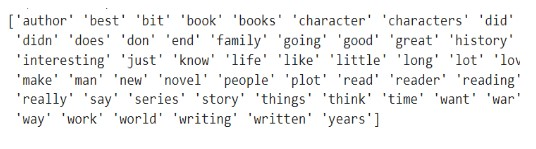

This shows us what TF-IDF learned. They are a bit similar to the BOW, as they come from very similar nature.

In [ ]:
from scipy import sparse
import numpy as nps


# Save the TF-IDF matrix
sparse.save_npz('tfidf_matrix.npz', tfidf_matrix)


np.save('tfidf_vectorizer_features.npy', vectorizer.get_feature_names_out())

Now saving a df with the features.

In [ ]:
tfidf_dense = tfidf_matrix.todense()

tfidf_df = pd.DataFrame(tfidf_dense, columns=vectorizer.get_feature_names_out())

df_combined = pd.concat([df_filtered.reset_index(drop=True), tfidf_df.reset_index(drop=True)], axis=1)

In [ ]:
df_combined.to_csv("/content/drive/MyDrive/df_tf_idf.csv")

### Extracting features using SBert

In order to try a different approach, we have decided to use a more "advanced" model creating embeddings. We have adopted Sentence-BERT (SBERT) to generate embeddings from the reviewText column. Unlike traditional method SBERT transforms each review into a dense vector representation that captures semantic meaning and context. This approach allows the system to understand the inherent similarity between reviews based on their content, rather than just word frequency or occurrence.

In [ ]:
import torch
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')


In [ ]:
df_filtered=pd.read_csv("/content/drive/MyDrive/df_for_recommendations_systems_50_to_100_reviews.csv")

In [ ]:
import torch
from sentence_transformers import SentenceTransformer
import pandas as pd
from tqdm import tqdm
import numpy as np
import gc

# Load SBERT model
model_name = 'sentence-transformers/all-MiniLM-L6-v2'  # A smaller, efficient SBERT model
model = SentenceTransformer(model_name)

# Check if GPU is available and move model accordingly
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")
model = model.to(device)

batch_size = 500
embeddings_save_dir = "/content/drive/MyDrive/distilled/"
all_embeddings = []

df_filtered = pd.read_csv("/content/drive/MyDrive/df_for_recommendations_systems_50_to_100_reviews.csv")

for i in tqdm(range(0, len(df_filtered), batch_size), desc="Processing batches"):
    batch_texts = df_filtered["reviewText"].iloc[i: i + batch_size].tolist()

    batch_embeddings = model.encode(batch_texts, batch_size=batch_size, show_progress_bar=False, convert_to_tensor=True, device=device)

    all_embeddings.extend(batch_embeddings.cpu().numpy())

    torch.cuda.empty_cache()
    gc.collect()

np.save(f"{embeddings_save_dir}sbert_embeddings.npy", all_embeddings)

all_embeddings = np.load(f"{embeddings_save_dir}sbert_embeddings.npy", allow_pickle=True)
df_filtered["embeddings"] = list(all_embeddings)

df_filtered.to_csv(f"{embeddings_save_dir}sbert_embeddings.csv", index=False)


## Dimensionality reduction

A common problem we encountered was working with a large number of features. To avoid the curse of dimensionality and obtain results that are interpretable and usable, we used dimensionality reduction

In [ ]:
bow_df_for_dr=pd.read_csv('/content/drive/MyDrive/bow_df.csv')

In [ ]:
#concating with the entire df
bow_df_for_dimensionality_reduction=pd.concat([bow_df_for_dr,df_filtered],axis=1)

keeping all of bow, overall(rating) and the style column


In [ ]:
bow_df_for_dimensionality_reduction_filtered=bow_df_for_dimensionality_reduction.iloc[:, list(range(1, 51))]

### PCA

First we resorted to PCA, as the most common and one of the fastest method, which does not require chunks in order to fit into the RAM.

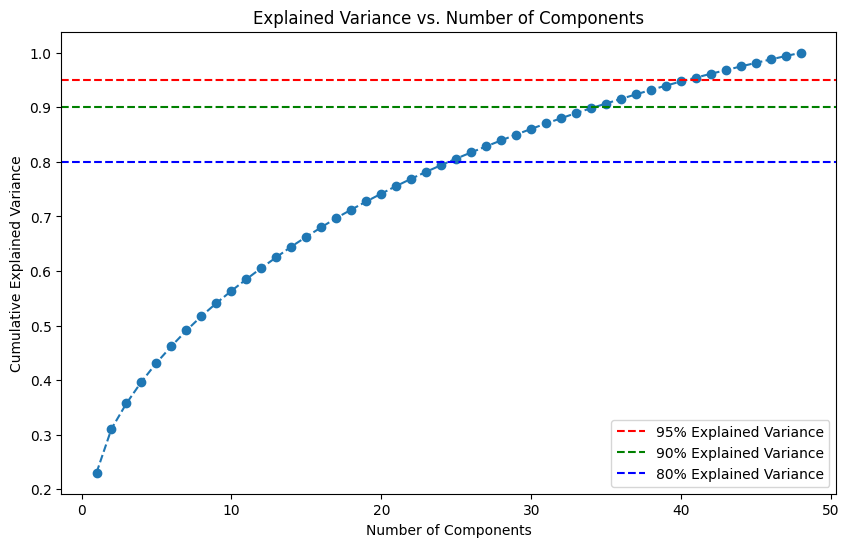

Number of components that explain 95% of the variance: 41
Number of components that explain 90% of the variance: 35
Number of components that explain 80% of the variance: 25


In [ ]:
from sklearn.decomposition import PCA

X = bow_df_for_dimensionality_reduction_filtered.iloc[:, :-2]

pca = PCA()
pca.fit(X)

# Calculate the cumulative explained variance
cumulative_explained_variance = np.cumsum(pca.explained_variance_ratio_)

# Plot the cumulative explained variance
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(cumulative_explained_variance) + 1), cumulative_explained_variance, marker='o', linestyle='--')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Explained Variance vs. Number of Components')
plt.axhline(y=0.95, color='r', linestyle='--', label='95% Explained Variance')
plt.axhline(y=0.90, color='g', linestyle='--', label='90% Explained Variance')
plt.axhline(y=0.80, color='b', linestyle='--', label='80% Explained Variance')
plt.legend()
plt.show()

# Determine the number of components that explain **% of the variance
n_components_95 = np.argmax(cumulative_explained_variance >= 0.95) + 1
print(f'Number of components that explain 95% of the variance: {n_components_95}')


n_components_90 = np.argmax(cumulative_explained_variance >= 0.90) + 1
print(f'Number of components that explain 90% of the variance: {n_components_90}')

n_components_80 = np.argmax(cumulative_explained_variance >= 0.80) + 1
print(f'Number of components that explain 80% of the variance: {n_components_80}')


This graph allows us to understand the ideal number of components for our needs. As much as we would like to use all 50 features, it is better under our computational limits to use only 25 as they explain 80% of the variance, which is satisfactory for the current needs.

Next we will merge it back to the original df and save it for future use.

In [ ]:
n_components_80 = np.argmax(cumulative_explained_variance >= 0.8) + 1
print(f'Number of components that explain 80% of the variance: {n_components_80}')

pca = PCA(n_components=n_components_80)
X_pca = pca.fit_transform(X)

pca_columns = [f'pca_{i+1}' for i in range(n_components_80)]
pca_df = pd.DataFrame(X_pca, columns=pca_columns)

df_with_pca = pd.concat([bow_df_for_dimensionality_reduction_filtered.reset_index(drop=True), pca_df], axis=1)

df_with_pca.head()

Number of components that explain 80% of the variance: 25


,author,best,bit,book,books,character,characters,did,didn,does,...,pca_16,pca_17,pca_18,pca_19,pca_20,pca_21,pca_22,pca_23,pca_24,pca_25
0,0,0,0,1,0,0,0,0,0,0,...,-0.038481,-0.078307,0.020229,-0.041195,0.015170,-0.156939,-0.091354,-0.119762,-0.136349,0.114998
1,0,0,0,1,0,0,0,0,0,0,...,-0.021586,-0.182302,0.063954,-0.282469,-0.053524,-0.172129,-0.184945,0.164420,-0.132883,-0.125049
2,0,0,0,0,0,0,0,0,0,1,...,-0.457261,0.146258,-0.690896,0.245567,1.344517,0.455241,-0.932067,0.751194,0.680877,0.274272
3,0,0,1,2,0,0,0,0,0,0,...,-0.189481,-0.147345,0.018533,-0.343236,-0.401939,0.278119,-0.197931,-0.112132,-0.165749,0.011193
4,0,0,0,2,1,0,0,0,0,0,...,0.100168,-0.629470,0.395732,0.362874,0.099025,-0.100332,-0.158631,0.328904,-0.290690,0.202078


In [ ]:
df_with_pca.to_csv("/content/drive/MyDrive/df_with_pca.csv")

### t-SNE

t-SNE is another dimensionality reduction technique, which is suitable and deemed a good use for text because it can capture complex, non-linear relationships between words or documents, making it effective for visualizing semantic similarity. Additionally, t-SNE can handle high-dimensional and sparse data, which are common characteristics of text data. Furthermore, the visualizations produced by t-SNE can provide intuitive insights into the structure and topics present in a text dataset.

Unfortunality, t-SNE took forever to run, even when we chose the minimal values possible. In order to overcome this obstacle, we decided to try using PCA first and then t-SNE. We chose 40% of the variance just to get a sense of what will happen with this data, and even this small amount of dimensions took way way too long to run, realising that with the current data and computation power, we simply cannot run T-SNE, making it unsuitable for our needs.
Thus, we have decided to use only 5000 samples- just to get to know the tool and see if we might be missing anything of great importance by deciding to neglect this.

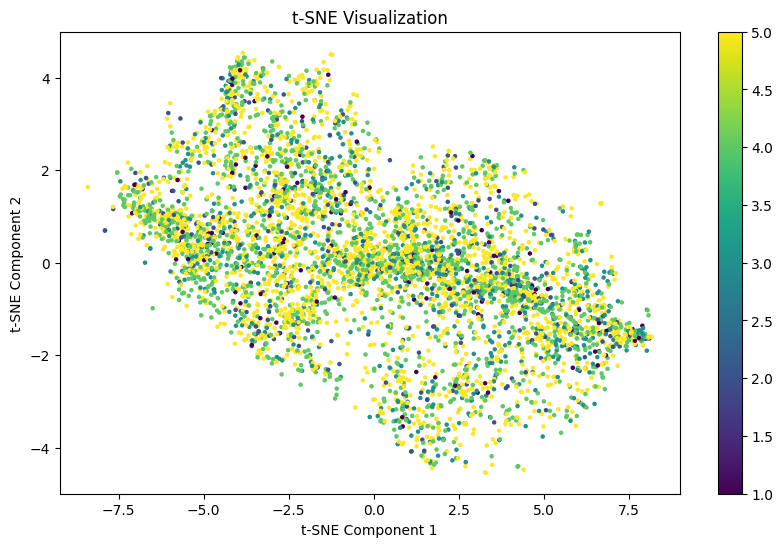

In [ ]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

X = bow_df_for_dimensionality_reduction_filtered.iloc[:, :-2].head(5000)

# Apply t-SNE on the PCA-transformed data
tsne = TSNE(n_components=2, perplexity=15, n_iter=300)
X_tsne = tsne.fit_transform(X)

# Plot t-SNE results
plt.figure(figsize=(10, 6))
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=bow_df_for_dimensionality_reduction_filtered['overall'].head(5000), cmap='viridis', s=5)
plt.colorbar()
plt.title('t-SNE Visualization')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.show()

The results of running this algorithm has shown no significant patterns or clsutering visible to the maked eye.

### UMAP

UMAP works in a similar fashion to t-SNE with different distribution assumptions of the data and loss functions.

In [ ]:
import matplotlib.pyplot as plt
import umap.umap_ as umap

# Exclude the last two columns (overall and style)
X = bow_df_for_dimensionality_reduction_filtered.iloc[:, :-2]
# Apply UMAP
reducer = umap.UMAP(n_components=3,n_neighbors=40)
X_umap = reducer.fit_transform(X)

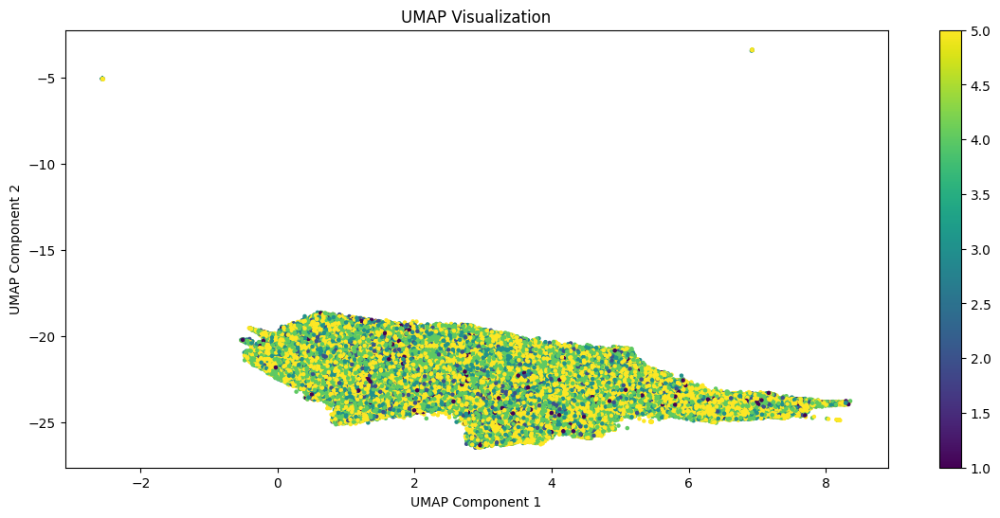

In [ ]:
# Plot UMAP results
plt.figure(figsize=(14, 6))
plt.scatter(X_umap[:, 0], X_umap[:, 1], c=bow_df_for_dimensionality_reduction['overall'], cmap='viridis', s=5)
plt.colorbar()
plt.title('UMAP Visualization')
plt.xlabel('UMAP Component 1')
plt.ylabel('UMAP Component 2')
plt.show()

After trying several paramters tuning which were relevant to our data, we have decided to show this one. This dimensionality reduction is not successful and probably the data with BOW does not fit into this method.

## Clustering

An important note before trying to create clustering is that clusters already exist in our data in two senses: one is that each user is her own cluster, and another is that each book is its own cluster.

### DBSCAN

We would start by clustering with features extracted using tf-idf. Clustering based on the text of the reviews as tf-idf will group reviews by similarity in terms of word usage and topic presence.



In [ ]:
tfidf_df = pd.read_csv("/content/drive/MyDrive/df_tf_idf.csv")


We needed to create some preprocess, explaining the style, as well as scaling numerical features for the clustering process to be more efficient.

In [ ]:
tfidf_df.drop(columns=['Unnamed: 0', '__index_level_0__', 'reviewerID', 'asin'], inplace=True)

tfidf_df['verified'] = tfidf_df['verified'].astype(int)

style_mapping = {
    "{'Format:': ' Hardcover'}": 1,
    "{'Format:': ' Mass Market Paperback'}": 2,
    "{'Format:': ' Paperback'}": 3,
    "{'Format:': ' Kindle Edition'}": 4
}

# Apply the mapping to the style column
tfidf_df['style'] = tfidf_df['style'].map(style_mapping)
features = [col for col in tfidf_df.columns if col not in ['reviewText', 'summary']]
from sklearn.preprocessing import StandardScaler
# Scale the numerical features
scaler = StandardScaler()
X = scaler.fit_transform(tfidf_df[features])


We want to create a visuzliation of the dbscan to see how the clusters look like.

In order for the algorithm to work, we had to create another dimensionality reduction, with 5 components this time. Then we ran dbscan and then another PCA in order to create a visualization.

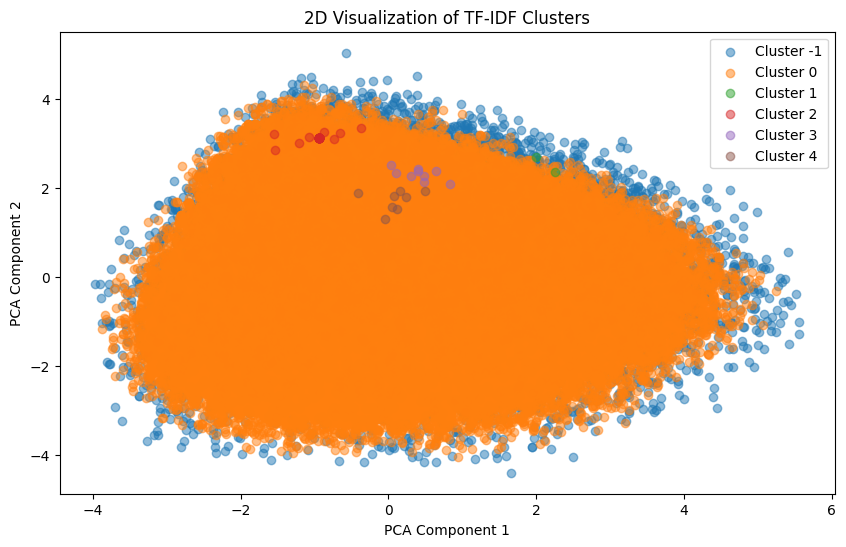

In [ ]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.cluster import DBSCAN

pca = PCA(n_components=5)
X_reduced = pca.fit_transform(X)

dbscan_tfidf_reduced = DBSCAN(eps=0.65, min_samples=10)
tfidf_df['cluster_tfidf_reduced'] = dbscan_tfidf_reduced.fit_predict(X_reduced)

pca_2d = PCA(n_components=2)
X_2d = pca_2d.fit_transform(X_reduced)

tfidf_df['PCA1_reduced'] = X_2d[:, 0]
tfidf_df['PCA2_reduced'] = X_2d[:, 1]

plt.figure(figsize=(10, 6))
for cluster in sorted(tfidf_df['cluster_tfidf_reduced'].unique()):
    cluster_data = tfidf_df[tfidf_df['cluster_tfidf_reduced'] == cluster]
    plt.scatter(cluster_data['PCA1_reduced'], cluster_data['PCA2_reduced'], label=f'Cluster {cluster}', alpha=0.5)
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.title('2D Visualization of TF-IDF Clusters')
plt.legend()
plt.show()


We have tried many values for the algorithm including: varied amount of dimension before applying the dbscan algorithm, different values for epsilon, and different values for the min_samples. In each case we ended up with small clusters, large number of noise points and overlapping clusters.
Our conclusion is that data does not have clear separations that DBSCAN can identify with the tested parameters.

We would now move to clustering using the data that contains the features extracted using sbert.

In [ ]:
additional_data = pd.read_csv('/content/drive/MyDrive/distilled/sbert_embeddings.csv')
sbert_embeddings = np.load('/content/drive/MyDrive/distilled/sbert_embeddings.npy')

In this again we needed to format the style and use PCA.

In [ ]:
from sklearn.decomposition import PCA

additional_data.drop(columns=['Unnamed: 0', '__index_level_0__', 'reviewerID', 'asin'], inplace=True)
additional_data['verified'] = additional_data['verified'].astype(int)
style_mapping = {
    "{'Format:': ' Hardcover'}": 1,
    "{'Format:': ' Mass Market Paperback'}": 2,
    "{'Format:': ' Paperback'}": 3,
    "{'Format:': ' Kindle Edition'}": 4
}
additional_data['style'] = additional_data['style'].map(style_mapping)
features_to_scale = ['overall', 'verified', "style"]

scaler = StandardScaler()
scaled_additional_features = scaler.fit_transform(additional_data[features_to_scale])
scaled_embeddings = scaler.fit_transform(sbert_embeddings)

combined_features = np.hstack([scaled_additional_features, scaled_embeddings])

pca = PCA(n_components=5)
X_reduced = pca.fit_transform(combined_features)

In [ ]:
dbscan = DBSCAN(eps=0.3, min_samples=15)
additional_data['cluster'] = dbscan.fit_predict(X_reduced)

In [ ]:
additional_data.to_csv("/content/drive/MyDrive/clustered_embeddings_data.csv", index=False)

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


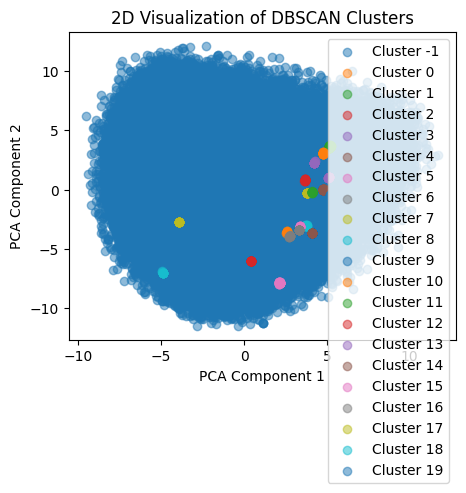

In [ ]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

pca_2d = PCA(n_components=2)
X_2d = pca_2d.fit_transform(X_reduced)
plot_data = pd.DataFrame(X_2d, columns=['PCA1', 'PCA2'])
plot_data['cluster'] = additional_data['cluster']
plt.figure(figsize=(5, 4))
for cluster in sorted(plot_data['cluster'].unique()):
    cluster_data = plot_data[plot_data['cluster'] == cluster]
    plt.scatter(cluster_data['PCA1'], cluster_data['PCA2'], label=f'Cluster {cluster}', alpha=0.5)

plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.title('2D Visualization of DBSCAN Clusters')
plt.legend()
plt.show()


Once again,  the clusters are not distinctly separated. This might indicate that DBSCAN with the current parameter settings is not effectively capturing the natural groupings in our data, and trying with further tuning of "eps" and "min_samples" as well as n_components of the pca before clustering, didn't seem to change the situation. Our conclusion is that DBSCAN is not suitable for this dataset. Next, we would use K-Means to try other clustering method.

The next function is used to perform K-means clustering and plotting for both of the dataframes containing the features extracted from 1. tfidf and 2. sbert dataframe.

In [ ]:
from sklearn.cluster import KMeans
def kmeans_clustering_and_plotting(df, n_clusters, title, output_file):
    features = [col for col in df.columns if col not in ['reviewText', 'summary', 'cluster']]
    scaler = StandardScaler()
    X = scaler.fit_transform(df[features])

    pca = PCA(n_components=0.85)
    X_reduced = pca.fit_transform(X)

    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    kmeans.fit(X_reduced)
    df['cluster'] = kmeans.labels_

    df.to_csv(output_file, index=False)

    pca_2d = PCA(n_components=2)
    X_2d = pca_2d.fit_transform(X_reduced)

    df_2d = pd.DataFrame(X_2d, columns=['PCA1', 'PCA2'])
    df_2d['cluster'] = df['cluster']

    plt.figure(figsize=(10, 6))
    for cluster in range(n_clusters):
        cluster_data = df_2d[df_2d['cluster'] == cluster]
        plt.scatter(cluster_data['PCA1'], cluster_data['PCA2'], label=f'Cluster {cluster}', alpha=0.5)

    plt.xlabel('PCA Component 1')
    plt.ylabel('PCA Component 2')
    plt.title(title)
    plt.legend()
    plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


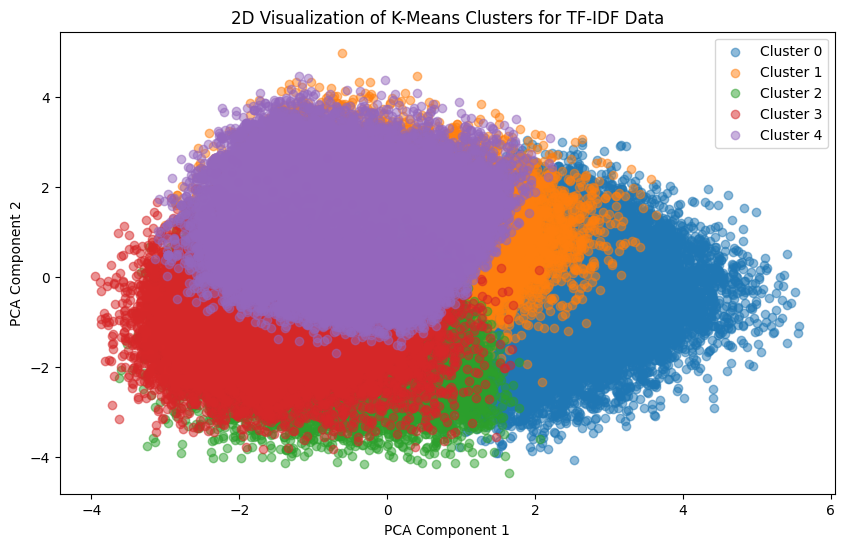

In [ ]:
kmeans_clustering_and_plotting(tfidf_df, n_clusters=5, title='2D Visualization of K-Means Clusters for TF-IDF Data', output_file="/content/drive/MyDrive/clustered_tfidf.csv")

This visualization shows us once again that the clusters are not seperated. Despite creating several clusters, they merge into one another and this is also a result of the way K means work.

Next we crate K means visualization for the s embeddings

In [ ]:
additional_data.head()

,overall,verified,style,reviewText,summary,embeddings
0,5,0,1,Over and over the king has problems. Fortunat...,Not Nice Mice,[-3.69857103e-02 6.62791803e-02 3.47475000e-...
1,5,0,1,This was a favorite. I think it changed my lif...,Changed my life,[-5.97363301e-02 1.75622925e-02 2.33366285e-...
2,5,0,1,"In this early reader, Dr. Seuss explores the c...",Two thumbs up for this early reader,[ 5.52748293e-02 -1.34186642e-02 7.35510215e-...
3,4,0,1,Dr. Suess's scansion and made-up words annoy m...,A fine first read with wonderful illustrations,[ 3.01924106e-02 1.63982231e-02 -1.87582988e-...
4,5,0,1,Christopher Kremmer's book takes you on a jour...,A compelling read,[-5.37788495e-02 5.34100458e-02 4.65276971e-...


In [ ]:
additional_data = pd.read_csv('/content/drive/MyDrive/distilled/sbert_embeddings.csv')
sbert_embeddings = np.load('/content/drive/MyDrive/distilled/sbert_embeddings.npy')

additional_data.drop(columns=['Unnamed: 0', '__index_level_0__', 'reviewerID', 'asin'], inplace=True)

style_mapping = {
    "{'Format:': ' Hardcover'}": 1,
    "{'Format:': ' Mass Market Paperback'}": 2,
    "{'Format:': ' Paperback'}": 3,
    "{'Format:': ' Kindle Edition'}": 4
}
additional_data['style'] = additional_data['style'].map(style_mapping)
features_to_scale = ['overall', 'verified', 'style']

scaler = StandardScaler()
scaled_additional_features = scaler.fit_transform(additional_data[features_to_scale])
scaled_embeddings = scaler.fit_transform(sbert_embeddings)

combined_features = np.hstack([scaled_additional_features, scaled_embeddings])

combined_columns = features_to_scale + [f'feature_{i}' for i in range(scaled_embeddings.shape[1])]

combined_df = pd.DataFrame(combined_features, columns=combined_columns)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


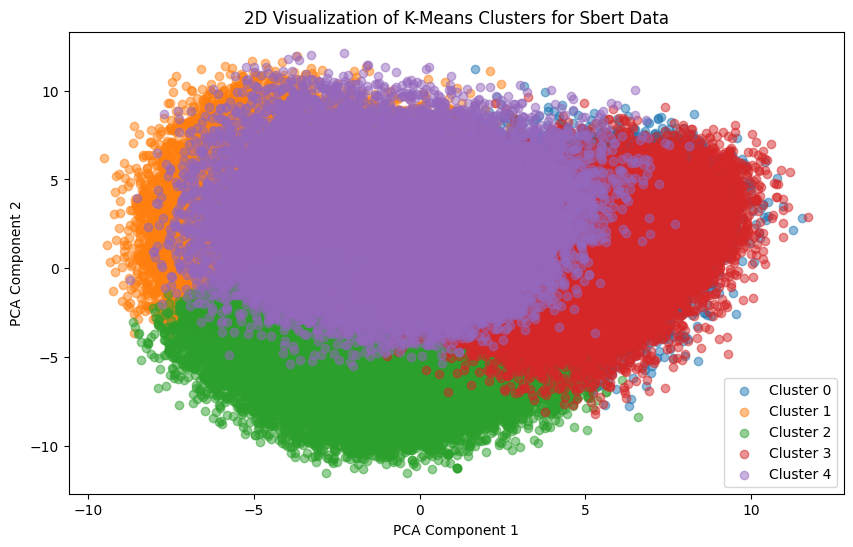

In [ ]:
kmeans_clustering_and_plotting(combined_df, n_clusters=5, title='2D Visualization of K-Means Clusters for Sbert Data', output_file="/content/drive/MyDrive/clustered_sbert.csv")


Once again we get clusters that merge into each other without clear distinction.

We will now compare the clustering using k-means with tf-idf and kmeans clustering with newer model for feature extraction, sbert:

In [ ]:
from sklearn.metrics import silhouette_score

def plot_silhouette_scores(df, n_clusters_range, title):
    features = [col for col in df.columns if col not in ['reviewText', 'summary', 'cluster']]

    scaler = StandardScaler()
    X = scaler.fit_transform(df[features])

    pca = PCA(n_components=0.85)
    X_reduced = pca.fit_transform(X)

    silhouette_scores = []
    for n_clusters in n_clusters_range:
        kmeans = KMeans(n_clusters=n_clusters, random_state=42)
        kmeans.fit(X_reduced)
        cluster_labels = kmeans.labels_
        silhouette_avg = silhouette_score(X_reduced, cluster_labels)
        silhouette_scores.append(silhouette_avg)

    # Plot silhouette scores
    plt.plot(n_clusters_range, silhouette_scores, marker='o', label=title)

n_clusters_range = range(2, 11)  # Evaluate from 2 to 10 clusters

plt.figure(figsize=(12, 8))

plot_silhouette_scores(tfidf_df, n_clusters_range, 'TF-IDF')

plot_silhouette_scores(combined_df, n_clusters_range, 'SBERT')

plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score vs. Number of Clusters for TF-IDF and SBERT')
plt.legend()
plt.show()

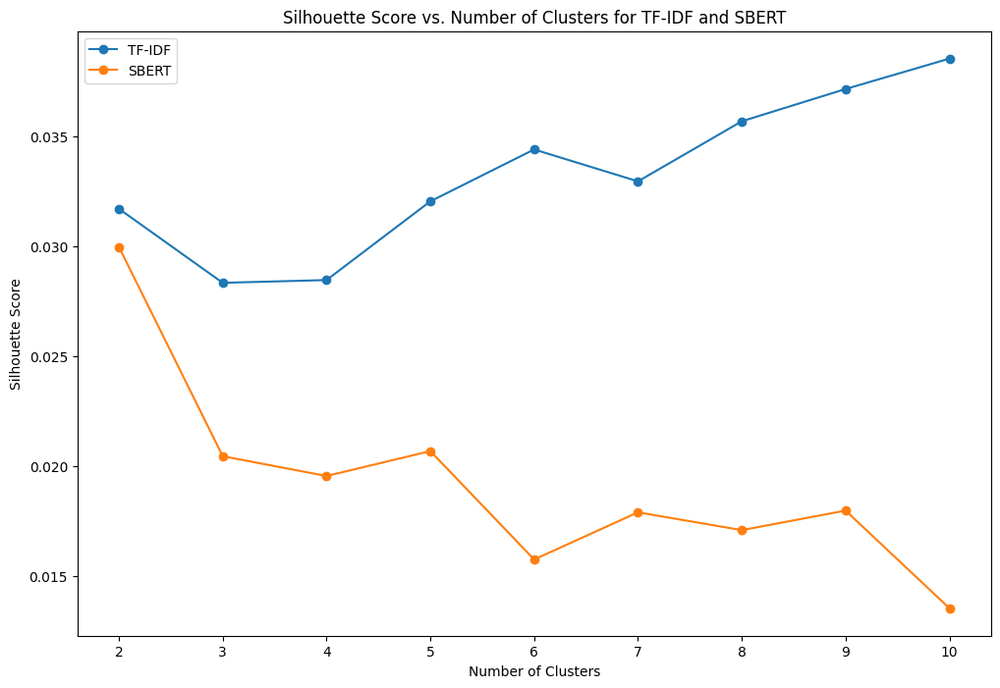

We experimented with various values of k across different clustering algorithms, focusing on TF-IDF and SBERT representations. Clustering data is meant for grouping similar items together and identifying patterns within the dataset. Despite our efforts to optimize the clustering process, the silhouette scores were extremely close to 0 (whereas it should ideally be close to 1), indicating that our data does not form well-defined clusters. Consequently, the clustering quality is poor at best, with significant overlap between clusters and a lack of clear separation. Based on these results, we conclude that our recommendation systems would perform better without relying on these clustering values, and we should explore alternative approaches to organize and analyze our data.

## Sentiment

#### Adding sentiment

Since our data is composed of reviews for book products bought on Amazon, we would like to use the review texts themselves and try to gain some more valuable information than plain rating that the reviewers gave to the product. One such way, is to use an already pre-trained models, a one that is based on a known one such as BERT. We will use it in order to extract the sentiment of the review.





We chose to use distilbert-base-uncased-finetuned-sst-2-english model which performance  is considered good and is much more efficient to run and finetuned. For each text returns "NEGATIVE", or "POSITIVE" and a number between 0.5 and 1, representing how much positive or negative the sentiment is.

In [ ]:
from transformers import pipeline, DistilBertTokenizer

sentiment_analysis = pipeline('sentiment-analysis', model="distilbert-base-uncased-finetuned-sst-2-english")

tokenizer = DistilBertTokenizer.from_pretrained("distilbert-base-uncased-finetuned-sst-2-english")

In the following code, we first created a method that uses the summary if it exists, and only if it doesn't, we would get the sentiment of the full review text. By manually examining the created sentiment, we saw that the sentiment of the summary usually generated poor results. For example, a row with a 5-star rating that had a summary "try it" got 0.6 in the positive sentiment (range is 0.5-1), which means it wasn't adding information for our model.
Then, after observing that sometimes a 3-star review might have very critical text, and some of the 3-star records actually have pretty good reviews, we decided to run the sentiment analysis on the full review text. However, due to the limitation of 512 tokens maximum passed to sentiment models, and due to the amount of data that needs to be processed for sentiment analysis (as well as lack of resources in terms of time and memory), we decided to take only the first 512 tokens.
For some reason, even that was too much for the sentiment model, so we decreased it further. Now the model is using only the first 510 tokens from every review.

In [ ]:
def get_sentiment_score(row):
    text = row['reviewText']
    if pd.isna(text):
        return None  # Return None if  reviewText is missing

    # Tokenize the text and truncate to the first 510 tokens
    tokens = tokenizer.encode(text, add_special_tokens=True, max_length=510, truncation=True)

    # Convert tokens back to text string if necessary
    truncated_text = tokenizer.decode(tokens)
    # Perform sentiment analysis
    result = sentiment_analysis(truncated_text)[0]
    if result['label'] == "NEGATIVE":
        score = -result['score']
    else:
        score = result['score']
    return (score, result['label'])  # Return tuple

result_df['sentiment_result'] = result_df.apply(get_sentiment_score, axis=1)

In [ ]:
result_df.head(3)

,overall,reviewerID,asin,style,__index_level_0__,extracted_category,sentiment_category
0,5,A3H9YD6K9TVKDP,0001713353,{'Format:': ' Hardcover'},15,Children's Books,0
1,5,A3QYDL5CDNYN66,0001061240,{'Format:': ' Hardcover'},47,Children's Books,3
2,5,A1BNWEJ7RVPLQ1,0001712799,{'Format:': ' Hardcover'},72,Children's Books,3


For the first 1000 records, we show some statistics about the results of the model

In [ ]:
result_df_head[['sentiment_score', 'sentiment_label']] = pd.DataFrame(result_df_head['sentiment_result'].tolist(), index=result_df_head.index)
print(result_df_head.head())

   Unnamed: 0  overall  verified      reviewerID        asin  \
0          15        5     False  A3H9YD6K9TVKDP  0001713353   
1          47        5     False  A3QYDL5CDNYN66  0001061240   
2          72        5     False  A1BNWEJ7RVPLQ1  0001712799   
3          98        4     False  A3CKPNSGA7JOLK  0001712799   
4         106        5     False  A2MOBMVHECYVLE  0002006448   

                       style  \
0  {'Format:': ' Hardcover'}   
1  {'Format:': ' Hardcover'}   
2  {'Format:': ' Hardcover'}   
3  {'Format:': ' Hardcover'}   
4  {'Format:': ' Hardcover'}   

                                          reviewText  \
0  Over and over the king has problems.  Fortunat...   
1  This was a favorite. I think it changed my lif...   
2  In this early reader, Dr. Seuss explores the c...   
3  Dr. Suess's scansion and made-up words annoy m...   
4  Christopher Kremmer's book takes you on a jour...   

                                          summary  __index_level_0__  \
0            

<ipython-input-10-6395239f7345>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  result_df_head[['sentiment_score', 'sentiment_label']] = pd.DataFrame(result_df_head['sentiment_result'].tolist(), index=result_df_head.index)
<ipython-input-10-6395239f7345>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  result_df_head[['sentiment_score', 'sentiment_label']] = pd.DataFrame(result_df_head['sentiment_result'].tolist(), index=result_df_head.index)


In [ ]:
result_df_head["sentiment_label" ].value_counts()

sentiment_label
POSITIVE    742
NEGATIVE    258
Name: count, dtype: int64

In [ ]:
result_df_head["sentiment_score" ].describe()

count    1000.000000
mean        0.479695
std         0.844819
min        -0.999821
25%        -0.629244
50%         0.994564
75%         0.999077
max         0.999890
Name: sentiment_score, dtype: float64

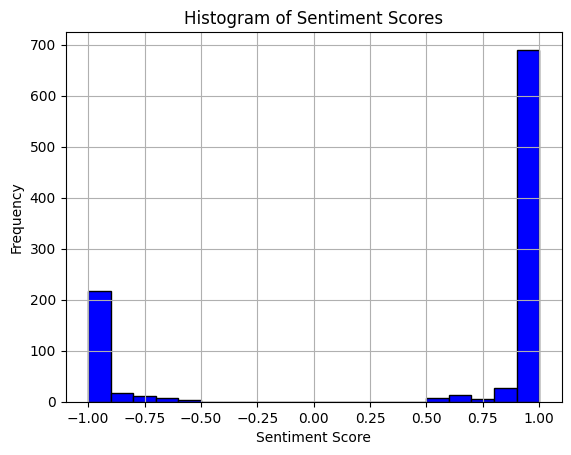

In [ ]:
import matplotlib.pyplot as plt
# Creating a histogram of the sentiment scores
plt.hist(result_df_head["sentiment_score"], bins=20, color='blue', edgecolor='black')
plt.title('Histogram of Sentiment Scores')
plt.xlabel('Sentiment Score')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

As we can see from our sample data, most of the data extracted from the review text is either very close to 1 or -1, meaning very positive or very negative, and there is a minority that falls between 0.5-0.9 or -0.5 and -0.9. The reason why there is no data between -0.5 and 0.5 is that the sentiment originally ranges from 0.5-1 for either positive or negative, which means that a positive 0.4 is equal to a negative 0.6, so the model is trained to classify the sentiment as either negative or positive. Because of this distribution of the data, we would like to perform discretization, so eventually, there would be only four values for the sentiment: values that are positive and above 0.9 would be classified as "loved," whereas those below that would be "liked." For negative sentiment, we would define values above 0.9 as "hated," and those below as "disliked.

In [ ]:
def get_sentiment_category(text):
    if pd.isna(text):
        return None

    tokens = tokenizer.encode(text, add_special_tokens=True, max_length=510, truncation=True)

    truncated_text = tokenizer.decode(tokens)

    result = sentiment_analysis(truncated_text)[0]
    score = result['score']
    sentiment = result['label']

    if sentiment == "POSITIVE":
        if score > 0.9:
            category = 3 # "Loved"
        else:
            category = 2 # "Liked"
    elif sentiment == "NEGATIVE":
        if score > 0.9:
            category = 0 # "Hated"
        else:
          category = 1 # "Disliked"

    return category  # Return the category
result_df['sentiment_category'] = result_df["reviewText"].apply(get_sentiment_category)
result_df = result_df.drop(columns=["verified", "reviewText", "summary"])
result_df.to_parquet('/content/drive/MyDrive/books_to_kindle_and_books_parquets/books/books_1_with_sentiment.parquet')
result_df.head()


We want to see the distribution of the sentiments.


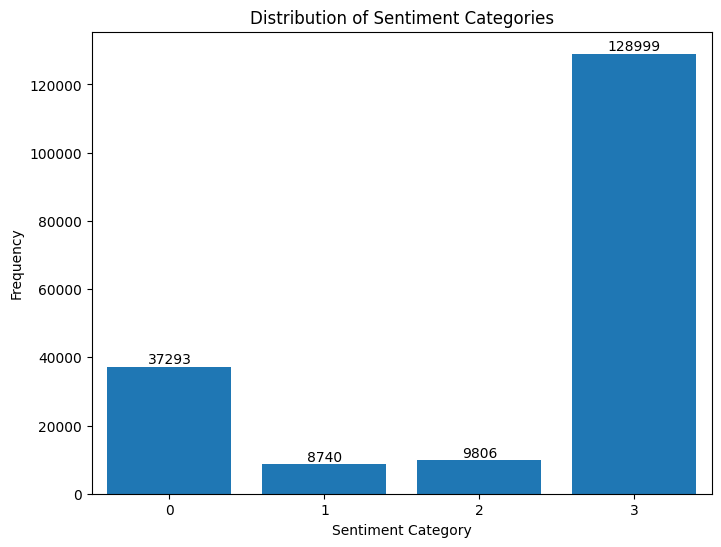

In [ ]:
value_counts=result_df["sentiment_category"].value_counts().sort_index()
# Create a bar graph
plt.figure(figsize=(8, 6))
bars = plt.bar(value_counts.index, value_counts.values, tick_label=value_counts.index)

# Add labels to each bar
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), va='bottom', ha='center')

# Set the x-axis limits
plt.xlim(-0.5, 3.5)

# Labeling the axes
plt.xlabel('Sentiment Category')
plt.ylabel('Frequency')
plt.title('Distribution of Sentiment Categories')

# Show the plot
plt.xticks(range(4))
plt.show()


As expected, mostly "hated" and "loved" are the most common reviews given. This is however not in linear fashion as to the first distribution we saw of how the ratings are scattered.

### Bertviz

\We wanted to use Bertviz because BertViz is a tool designed to visually interpret and explore the inner workings of BERT (Bidirectional Encoder Representations from Transformers) and other transformer models. It provides interactive visualizations of attention heads and attention patterns, allowing users to see how different parts of the input influence each other during model processing. This helps users understand the decision-making process of transformer models by making the complex attention mechanisms more transparent, helping them understand why the sentiment analysis occurred as it did.

In [ ]:
pos_bertviz=df_filtered[(df_filtered['reviewerID']=="A1SER5HLPRY6SB") & (df_filtered['asin']=="0001844423")]

In [ ]:
neg_bertviz=df_filtered[(df_filtered['reviewerID']=="A1B9VX6MZ0MZ1T") & (df_filtered['asin']=="0001844423")]


,overall,reviewerID,asin,style,__index_level_0__,extracted_category,sentiment_category
6,3,A1B9VX6MZ0MZ1T,0001844423,{'Format:': ' Mass Market Paperback'},7555,Christian Books & Bibles,0


We have two unique reviews, one with sentiment category of 3 and one with 0. As running Bertviz continually crushed our sessions, no matter what tricks/computers/ways we worked with, we understood it is of great problem. Also, the sentiment model we chose does not have any bertviz available inside it, as it is very fine tuned and very specific. Thus we have resorted to original and classic BERT models and we will visualize with bertviz for one positive sentiment and one negative to get a sense of what the model "learned".

In [ ]:
import torch
from transformers import BertTokenizer, BertForSequenceClassification
from bertviz import head_view, model_view

In [ ]:
model_name = "nlptown/bert-base-multilingual-uncased-sentiment"
model = BertForSequenceClassification.from_pretrained(model_name)
tokenizer = BertTokenizer.from_pretrained(model_name)

In [ ]:
review = pos_bertviz['reviewText'].iloc[0]

# Tokenize and encode the input review
inputs = tokenizer.encode_plus(
    review,
    return_tensors='pt',
    add_special_tokens=True,
    max_length=52,
    truncation=True,
    padding='max_length'
)
input_ids = inputs['input_ids']
attention_mask = inputs['attention_mask']


In [ ]:
# Get model outputs
outputs = model(input_ids, attention_mask=attention_mask, output_attentions=True)

# Visualize attention
attention = outputs.attentions  # Get attention scores
tokens = tokenizer.convert_ids_to_tokens(input_ids[0])


In [ ]:
head_view(attention, tokens)

<IPython.core.display.Javascript object>

# END OF FIRST NOTEBOOK